In [2]:
using Plots
using SparseArrays
using Random
using Combinatorics
using LinearAlgebra, Test
using Arpack
using LaTeXStrings
using LinearAlgebra

include("unitTests.jl")

ctc_calculation (generic function with 1 method)

In [43]:
L=14

d=Uniform(-1,1)
x=[-2.6001456976142046, -1.9610922506316708, 6.896195546956214, -8.209092219971941, 4.194225135719578, 7.84312938535132, 7.451840585169585, 5.16577895373286, 8.235078945666281, 6.486467976124979, 0.009964249225209443, 9.640132226146129]
x=[-2.841717689929655, -6.530240527509157, 7.331194499036611, 7.145559800868928, -7.887982105377402, -7.48849077081323, -7.966096949862913, -8.367992017606426, -9.41767536350056, -1.5450918031504468, -7.819985326421229, -9.878058704662223]
x=[-7.705204989516603, 9.239748431267763, 0.2626763358145423, 4.917542125206225, 9.980130110385016, -6.0506974748261255, 5.628126322406805, 1.8531974453519307, -2.4206763512780483, -1.3420028048645816, -1.3158219470231591, 1.0587680474005556, 5.74868816786611, 1.2017084791551058]

t=1
pbc=false
bonds=bonds1D(L, pbc)
H=build_anderson_hamiltonian_1d(x, bonds, L, t)
eigtemp=eigen(Hermitian(H));
V=Array{Float64, 4}(build_Vijkl_matrix(eigtemp.vectors));
E, zero_indicies=build_energy_differences_matrix(eigtemp.values);
V[zero_indicies].=0;
W4=build_W_matrix_tensor_op(eigtemp.values, eigtemp.vectors, V, E);
AGP_norm=find_norm_operator(W4)

0.6953937722430108

In [ ]:
AGP_norm

In [132]:
W = 10; # disorder strength
pbc=false
bonds=bonds1D(L, pbc)

all_new_dctc=[]
all_old_dctc=[]
#h = [8.694759243319189, 4.048727976250208, -2.2304852869181713, 1.1214837906442532, -3.8489735509192236, -0.5274983921134879, 5.295366242356416, -6.718009358261026, -9.767422707014264, 7.304567074104924, -5.578244513530124, 1.7222883207391737]
h=[-7.705204989516603, 9.239748431267763, 0.2626763358145423, 4.917542125206225, 9.980130110385016, -6.0506974748261255, 5.628126322406805, 1.8531974453519307, -2.4206763512780483, -1.3420028048645816, -1.3158219470231591, 1.0587680474005556, 5.74868816786611, 1.2017084791551058]

i_0=div(L,2)

H=build_anderson_hamiltonian_1d(h, bonds, L, t)

eigtemp=eigen(Hermitian(H));
eigtemp.vectors[]

J_mag=0
J = J_mag*ones(Float64, L); # interactions

construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, J, h, t,the_map, false, "full")

LoadError: MethodError: [0mCannot `convert` an object of type [92mVector{Float64}[39m[0m to an object of type [91mFloat64[39m

[0mClosest candidates are:
[0m  convert(::Type{Float64}, [91m::Measures.AbsoluteLength[39m)
[0m[90m   @[39m [33mMeasures[39m [90m~/.julia/packages/Measures/PKOxJ/src/[39m[90m[4mlength.jl:12[24m[39m
[0m  convert(::Type{T}, [91m::Polynomials.AbstractPolynomial{T, X}[39m) where {T<:Number, X}
[0m[90m   @[39m [35mPolynomials[39m [90m~/.julia/packages/Polynomials/fboHv/src/[39m[90m[4mcommon.jl:493[24m[39m
[0m  convert(::Type{T}, [91m::VectorizationBase.AbstractSIMD[39m) where T<:Union{Bool, Float16, Float32, Float64, Int16, Int32, Int64, Int8, UInt16, UInt32, UInt64, UInt8, SIMDTypes.Bit}
[0m[90m   @[39m [32mVectorizationBase[39m [90m~/.julia/packages/VectorizationBase/jSp7w/src/[39m[90m[4mbase_defs.jl:201[24m[39m
[0m  ...


In [ ]:
function build_orbital_creation_operator(alpha, L, J, h, t,the_map, pbc=false, "full")
    bonds=bonds1D(L, pbc)
    i_0=div(L,2)
    
    H=build_anderson_hamiltonian_1d(h, bonds, L, t) 
    eigtemp=eigen(Hermitian(H));
    the_vector=eigtemp.vectors[alpha, :]
    the_ts=[]
end

# play around with a single disorder realization

In [192]:
L= 12; # system size
T = 1 # random hopping strength
t = T*ones(Float64, L); #hopping
#t = ones(L)
W = 10; # disorder strength

theee_test=[]
deltah=0.1

all_new_dctc=[]
all_old_dctc=[]

#for its=1:1
d=Uniform(-1,1)
h=W*rand(d, L)
#h = [8.694759243319189, 4.048727976250208, -2.2304852869181713, 1.1214837906442532, -3.8489735509192236, -0.5274983921134879, 5.295366242356416, -6.718009358261026, -9.767422707014264, 7.304567074104924, -5.578244513530124, 1.7222883207391737]
#h=[-7.705204989516603, 9.239748431267763, 0.2626763358145423, 4.917542125206225, 9.980130110385016, -6.0506974748261255, 5.628126322406805, 1.8531974453519307, -2.4206763512780483, -1.3420028048645816, -1.3158219470231591, 1.0587680474005556, 5.74868816786611, 1.2017084791551058]

#h=[-7.705204989516603, 9.239748431267763, 0.2626763358145423, 4.917542125206225, 9.980130110385016, -6.0506974748261255, 5.628126322406805, 1.8531974453519307, -2.4206763512780483, -1.3420028048645816, -1.3158219470231591, 1.0587680474005556, 5.74868816786611, 1.2017084791551058]
#h=[9.239748431267763, 0.2626763358145423, 4.917542125206225, 9.980130110385016, -6.0506974748261255, 5.628126322406805, 1.8531974453519307, -2.4206763512780483, -1.3420028048645816, -1.3158219470231591, 1.0587680474005556, 5.74868816786611]
h=[(rand()*2*W)-W,0.10904748080484916, 9.576039625309399, 2.121748436613251, -6.375660141067949, -4.9544505756348745, -3.4038160518674587, 7.584267256760704, -6.321994543259779, -4.750027008368781, -2.9064645959633784,(rand()*2*W)-W]
#h=[(rand()*2*W)-W,(rand()*2*W)-W,9.546152730987004, 6.944271450174931, 8.561972625262456, -3.913919901458245, 6.308286232174735, -9.014759179085363, 0.5221822107962804, -8.829912922860128, 6.028943162145999, 0.220807462519077, 5.205733278283775, 9.731579821678602,(rand()*2*W)-W,(rand()*2*W)-W]

#h=[8.5067096178521, 0.6803539151062488, -9.200209220425556, -1.1683955921785327, -0.14596074210336596, -7.354471278000703, 2.60102322591675, 9.95890413942391, -1.2966959703103598, -0.3498409034598726, -1.653849900357629, 2.0834804551316277]
#h=[8.833189469473034, -5.754644928339769, 2.694951387132949, -3.602494380494141, 7.117657723330614, 4.633177092557257, -6.520527255958579, -1.7473395287926485, 8.03485697810016, 5.477788406589797, 0, 2]
#h=[-2.6001456976142046, -1.9610922506316708, 6.896195546956214, -8.209092219971941, 4.194225135719578, 7.84312938535132, 7.451840585169585, 5.16577895373286, 8.235078945666281, 6.486467976124979, 0.009964249225209443, 9.640132226146129]

i_0=div(L,2)

J_mag=0.1
J = J_mag*ones(Float64, L); # interactions



# maps states to index
# the states start with indexing 0, while the index starts with 1
the_map=construct_map_of_n_filling_states(L, div(L,2))

J_temp = 1*ones(Float64, L); # interactions
interaction_half_filling, trash=construct_interaction_nearest_neighbhor_half_filling(L, J_temp, the_map, false, "full")

H_half_filling, max_index_half=construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, J, h, t,the_map, false, "full")
eigtemp=eigen(H_half_filling)

eigenvectors=eigtemp.vectors
N_R_nodiag=get_N_R_operator_eigenstate_basis(L, the_map, eigenvectors, div(L, 2))

#eigenvalues=eigen(N_R_nodiag'*N_R_nodiag).values
eigtemp_1=eigen(N_R_nodiag)
eigenvalues_1=eigtemp_1.values
eigenvectors_1=eigtemp_1.vectors
#println(sqrt(maximum(abs,eigenvalues)))
#println("CTC: ", (maximum(eigenvalues_1)-minimum(eigenvalues_1)))

values, vecs1, info=eigsolve(N_R_nodiag, 1, :SR; ishermitian=true);
values_2, vecs, info=eigsolve(N_R_nodiag, 1, :LR; ishermitian=true);
println("CTC 2:", values_2[1]-values[1])


N_R=get_N_L_operator(L,the_map, i_0)
N_R=eigenvectors'*N_R*eigenvectors

the_states=prepare_half_filling_state(eigenvectors, the_map, L, i_0)
v = abs.(the_states)           # |ψ|
A = abs.(N_R)                  # |N|
tmp = similar(v)               # workspace
mul!(tmp, A, v)                # tmp = A * v  (fast, BLAS / sparse matvec)
dynamical_upper_bound = dot(v, tmp)
println("DCTC with original init state: ", dynamical_upper_bound)    
push!(all_old_dctc, dynamical_upper_bound)

#=
v = abs.(eigenvectors_1[:,end])           # |ψ|
A = abs.(N_R)                  # |N|
tmp = similar(v)               # workspace
mul!(tmp, A, v)                # tmp = A * v  (fast, BLAS / sparse matvec)
dynamical_upper_bound = dot(v, tmp) - eigenvectors_1[:,end]'*N_R*eigenvectors_1[:,end]
println("DCTC with diff init state: ", dynamical_upper_bound)   
=#

v = abs.(vecs[1])           # |ψ|
A = abs.(N_R)                  # |N|
tmp = similar(v)               # workspace
mul!(tmp, A, v)                # tmp = A * v  (fast, BLAS / sparse matvec)
dynamical_upper_bound = dot(v, tmp) - vecs[1]'*N_R*vecs[1]
println("DCTC with diff init state 2: ", dynamical_upper_bound) 

    push!(all_new_dctc, dynamical_upper_bound)

#println(sqrt(norm(N_R_nodiag)^2/(binomial(L, div(L,2)))))
#println(eigtemp.values)

N_R=eigtemp.vectors'*get_N_R_operator(L,the_map, div(L,2))*eigtemp.vectors;


#=
particle_number=[]
max_time=30000
for t=0:10:max_time
        time_evolved=time_evolve_state(vecs[1], eigtemp.values, t)
        number_particles_left=real(measure_number_particles_left_of_i_0(time_evolved, the_map,eigtemp.vectors, L, i_0))
        push!(particle_number, number_particles_left)
end

particle_number_2=[]

for t=0:10:max_time
        time_evolved=time_evolve_state(the_states, eigtemp.values, t)
        number_particles_left=real(measure_number_particles_left_of_i_0(time_evolved, the_map,eigtemp.vectors, L, i_0))
        push!(particle_number_2, number_particles_left)
end
    #stephist(real.(eigenvalues_1), bins=100, xlabel="Eigenvalue", ylabel="Frequency", label=false)
#end

=#
# get inverted map
inverted_dict = Dict{valtype(the_map), Vector{keytype(the_map)}}()

for (k, v) in the_map
    push!(get!(() -> valtype(inverted_dict)[], inverted_dict, v), k)
end
#println("next smallest ctc: "*string(eigenvalues_1[end-1]-eigenvalues_1[2]))
print("overlap: ", dot(abs.(eigenvectors_1[:,end]), abs.(eigenvectors_1[:,1])))

# n_i configutration 1
exp_n_1=[vecs1[1]'*eigtemp.vectors'*get_n_i_operator_half_filling(i, L, the_map)*eigtemp.vectors*vecs1[1] for i=1:L]
# n_i configuration 2
exp_n=[vecs[1]'*eigtemp.vectors'*get_n_i_operator_half_filling(i, L, the_map)*eigtemp.vectors*vecs[1] for i=1:L]
delta_n=real.(exp_n)-real.(exp_n_1)

delta_n=real.(exp_n)-real.(exp_n_1)
total_mass_left=0
total_mass_right=0
center_of_mass_right=0
center_of_mass_left=0
for i=i_0+1:L
    center_of_mass_right+=(i-i_0)*abs(delta_n[i])
    total_mass_right+=abs(delta_n[i])
end

for i=1:i_0
    center_of_mass_left+=-(i_0-i)*abs(delta_n[i])
    total_mass_left+=abs(delta_n[i])
end
center_of_mass_left=center_of_mass_left/(total_mass_left)
center_of_mass_right=center_of_mass_right/(total_mass_right)

println()

CTC 2:1.6634610912292436
DCTC with original init state: 1.4194786097160095
DCTC with diff init state 2: 1.8149313479794906
overlap: 0.9302243365426639


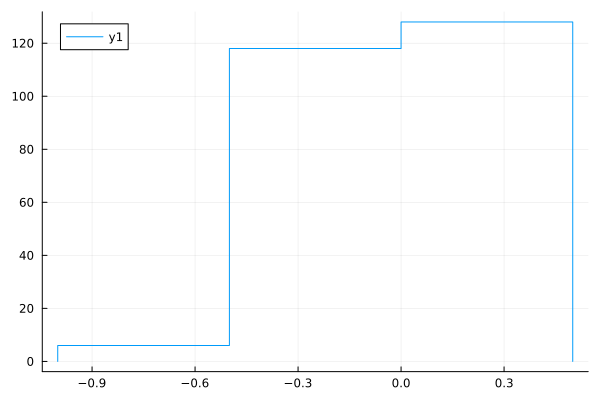

In [184]:
stephist(eigenvalues_1)

In [830]:
findall(x -> x .> 0.1, abs2.(eigtemp.vectors[:,190]))


1-element Vector{Int64}:
 290

In [831]:
# cmp basis states relevant for the second disorder realization
[326, 327]
[230, 231]

# first disorder realization relevant computational basis states
[535]
[466]

# third disorder realization relevant comp basis states
[453, 456]
[245]

1-element Vector{Int64}:
 466

In [6]:
indicies=[]
for i=1:length(eigtemp.values)
    the_eigenstate=eigtemp.vectors[:, i]
    if((abs2.(eigtemp.vectors[804, i])) > 0.05 || (abs2.(eigtemp.vectors[805, i])) > 0.05)
        push!(indicies, i)
    end
end

In [7]:
indicies

4-element Vector{Any}:
  50
  95
 618
 725

In [894]:
indicies=[]
for i=1:length(eigtemp.values)
    the_eigenstate=eigtemp.vectors[:, i]
    if((abs2.(eigtemp.vectors[245, i])) > 0.05)
        push!(indicies, i)
    end
end

In [895]:
indicies

4-element Vector{Any}:
 381
 428
 515
 578

In [836]:
inverted_dict[326]

1-element Vector{Int64}:
 1482

In [862]:
inverted_dict[231]

1-element Vector{Int64}:
 1148

In [ ]:
# idea: loop through all anderson eigenstates and find the ones which have support that eigenstates 804 and 805 did.

In [581]:
eigenstate_basis_interaction=eigtemp.vectors'*interaction_half_filling*eigtemp.vectors
diagonal_interaction_pieces=diag(eigenstate_basis_interaction)

924-element Vector{Float64}:
 2.0688504202616196
 2.8959958361676885
 2.0752472777913122
 2.9365713155565634
 1.9910369787458848
 2.9435188028055648
 2.0796794320589975
 2.1555229142265766
 2.0650907046834077
 2.8915124212509244
 1.9666464948938644
 3.9645637233258126
 2.060296906368966
 ⋮
 2.96492368247388
 1.0261534236305567
 2.8915092890273413
 2.065073742349772
 1.1730158539815494
 1.0973533507918867
 2.9433381575169717
 1.050706252756252
 1.9540815513344971
 2.0752289777763915
 1.9136684172192955
 1.086345488248209

In [914]:
particle_number=[]
the_max_state=[]
max_particles=0
max_time=20000
for t=0:10:max_time
        time_evolved=time_evolve_state(vecs[1], eigtemp.values, t)
        number_particles_left=real(measure_number_particles_left_of_i_0(time_evolved, the_map,eigtemp.vectors, L, i_0))
    if(number_particles_left>=max_particles)
        max_particles=number_particles_left
        the_max_state=time_evolved
    end
        push!(particle_number, number_particles_left)
end
println(maximum(particle_number .- particle_number[1]))

1.5182042642612048


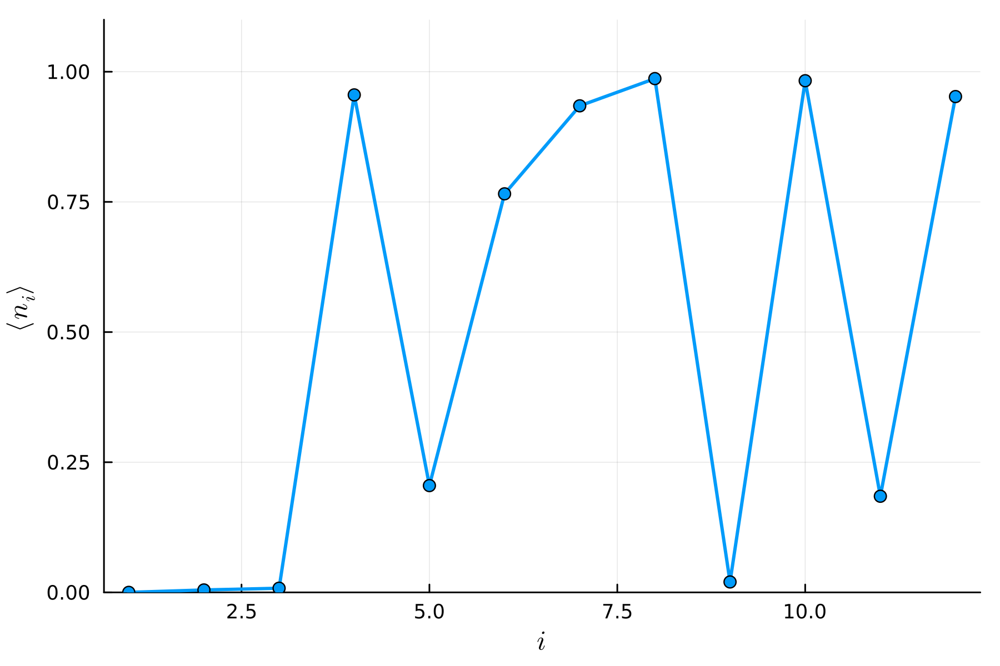

In [975]:
exp_n=[eigenvectors_1[:, end]'*eigtemp.vectors'*get_n_i_operator_half_filling(i, L, the_map)*eigtemp.vectors*eigenvectors_1[:, end] for i=1:L]
plot(real.(exp_n), xlabel=L"i", ylabel=L"\langle n_i\rangle", linewidth=2, marker=:circle, label="", yrange=(0,1.1))

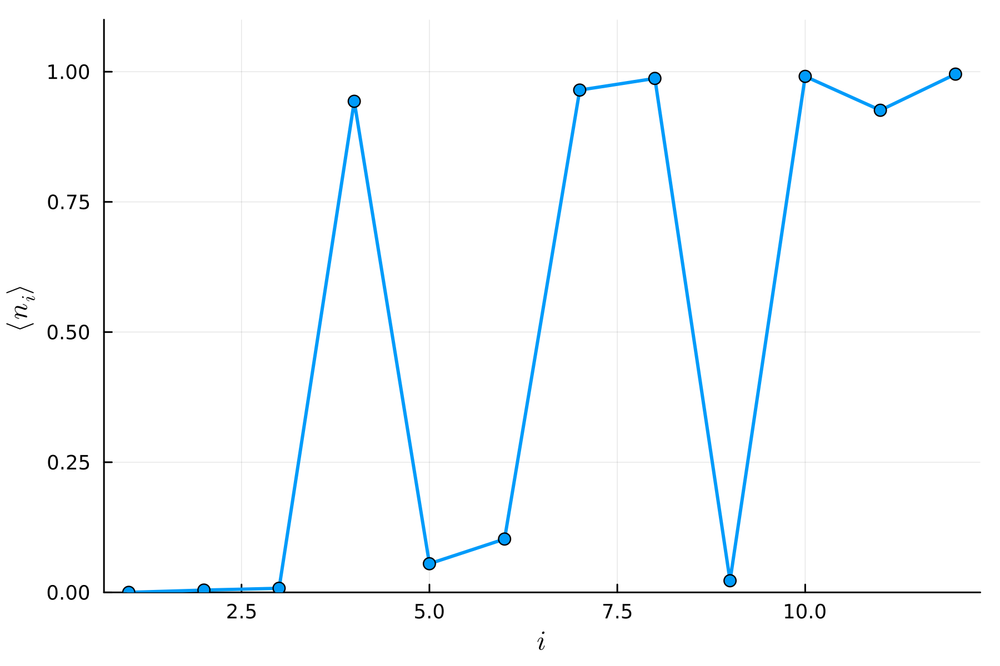

In [976]:
exp_n_1=[eigenvectors_1[:, 1]'*eigtemp.vectors'*get_n_i_operator_half_filling(i, L, the_map)*eigtemp.vectors*eigenvectors_1[:, 1] for i=1:L]
plot(real.(exp_n_1), xlabel=L"i", ylabel=L"\langle n_i\rangle", linewidth=2, marker=:circle, label="", yrange=(0,1.1))

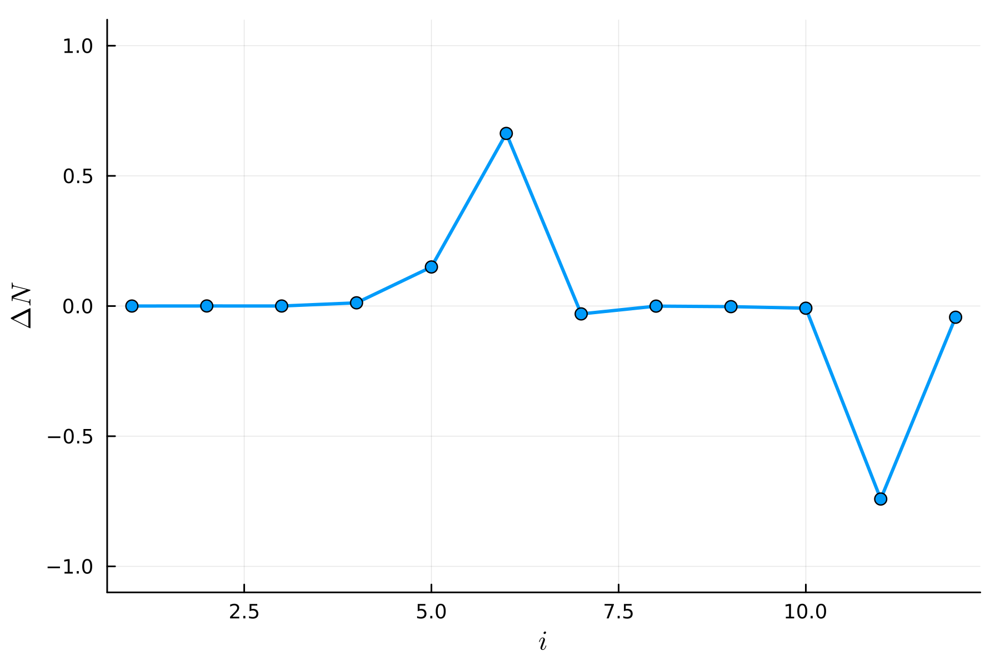

In [977]:
plot(real.(exp_n)-real.(exp_n_1), xlabel=L"i", ylabel=L"\Delta N", linewidth=2, marker=:circle, label="", yrange=(-1.1,1.1))

In [972]:
abs(eigenvectors_1[:, 1]'* N_R * eigenvectors_1[:, 1]-eigenvectors_1[:, end]' * N_R * eigenvectors_1[:, end])

0.9738656836087975

In [541]:
eigenstate_basis_interaction=eigenvectors'*interaction_half_filling*eigenvectors/0.1

924×924 Matrix{Float64}:
  2.06581      -0.059794     -4.37619e-7   …  -1.39895e-16  -3.86536e-17
 -0.059794      2.89156      -1.91646e-5      -2.02447e-17   6.12671e-16
 -4.37619e-7   -1.91646e-5    2.07211          1.83976e-16  -6.92096e-17
 -0.228872      0.00604451    3.75667e-8      -4.13598e-16   1.00101e-17
 -0.00932285    0.0955814    -2.16306e-6       4.55251e-15  -2.82759e-15
 -3.27829e-6    1.1381e-6     0.0393069    …  -1.59956e-17   1.33473e-18
 -0.00322833   -0.250439      1.45866e-6       8.15458e-17   2.79403e-16
  0.00924718   -0.00467146    1.32316e-5       9.26785e-17  -1.19403e-17
 -1.69694e-6   -3.79045e-6    0.0311499       -2.797e-16     2.79765e-17
  9.79947e-7   -4.58529e-6   -0.187482         5.33068e-17   4.577e-17
  0.00750425    0.017539     -4.62711e-7   …  -1.15939e-13  -8.08504e-16
  3.9321e-5    -0.000398311  -8.64048e-9      -1.95535e-17   4.67546e-18
 -0.00218849   -2.78616e-8   -0.00035166       7.17859e-14  -2.61127e-17
  ⋮                         

In [542]:
isHermitian(eigenstate_basis_interaction)

rows924


true

In [547]:
eigenstate_basis_interaction[804, 805]

-0.9049781413900343

In [ ]:
eigenstate_basis_interaction[805, 804]
-4.650398780078479e-18

In [565]:
eigenstate_basis_interaction[805, 804]

-0.9049781413900331

In [549]:
eigenstate_basis_interaction[805, 805]

2.18690570175386

In [264]:
eigenstate_basis_interaction[804, 804]

2.943846069340287

In [544]:
eigenstate_basis_interaction[803, 803]

2.0218811962946193

construct_interaction_nearest_neighbhor_half_filling (generic function with 3 methods)

In [561]:
include("unitTests.jl")
L=4
J=[1,1,1,1]
the_map=construct_map_of_n_filling_states(L, div(L,2))
h=[0,0,0,0]
interaction_half_filling, max_index_half=construct_interaction_nearest_neighbhor_half_filling(L, J, the_map, false, "full")

([1.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 1.0], Vector{Any}[[], [], [], []])

In [484]:
the_map

Dict{Int64, Int64} with 6 entries:
  5  => 2
  6  => 3
  10 => 5
  9  => 4
  12 => 6
  3  => 1

In [224]:
the_map

Dict{Int64, Int64} with 6 entries:
  5  => 2
  6  => 3
  10 => 5
  9  => 4
  12 => 6
  3  => 1

In [562]:
interaction_half_filling

6×6 Matrix{Float64}:
 1.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  1.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  1.0

In [233]:
H_half_filling

6×6 Matrix{Float64}:
 1.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  1.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  1.0

In [58]:
inverted_dict[1]

1-element Vector{Int64}:
 63

In [105]:
eigtemp.values[804]

11.858615660335603

In [106]:
eigtemp.values[805]

11.858675887724095

In [59]:
findall(abs2.(eigenvectors[:, 804]) .> 0.1)

1-element Vector{Int64}:
 217

In [60]:
inverted_dict[217]

1-element Vector{Int64}:
 1103

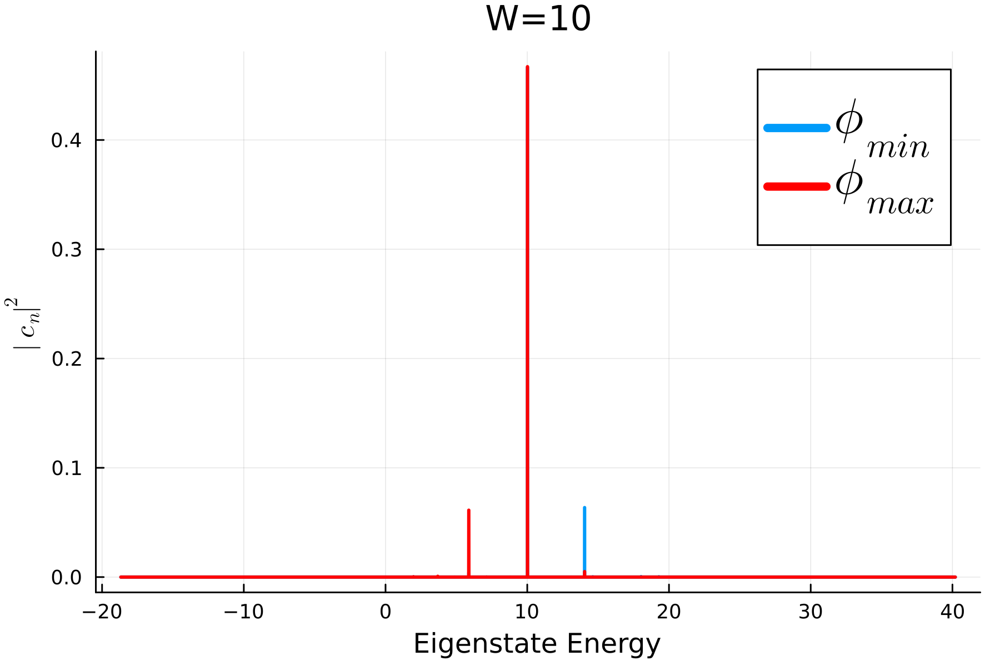

In [46]:
# in the basis of eigenvectors
# eigenvectors: rows: comp basis, col: eigenbasis
# eigenvectors_1 : each entry is eigenbasis
p=plot(eigtemp.values, abs2.((eigenvectors_1[:,1])), linewidth=2, ylabel=L"|c_n|^2", dpi=300, title="W="*string(W), label=L"\phi_{min}", legendfontsize=20)
plot!(p, eigtemp.values, abs2.((eigenvectors_1[:,end])), linewidth=2, xlabel="Eigenstate Energy", ylabel=L"|c_n|^2", dpi=300, title="W="*string(W), color="red", label=L"\phi_{max}")

display(p)
#savefig("computational_basis_weights.png")

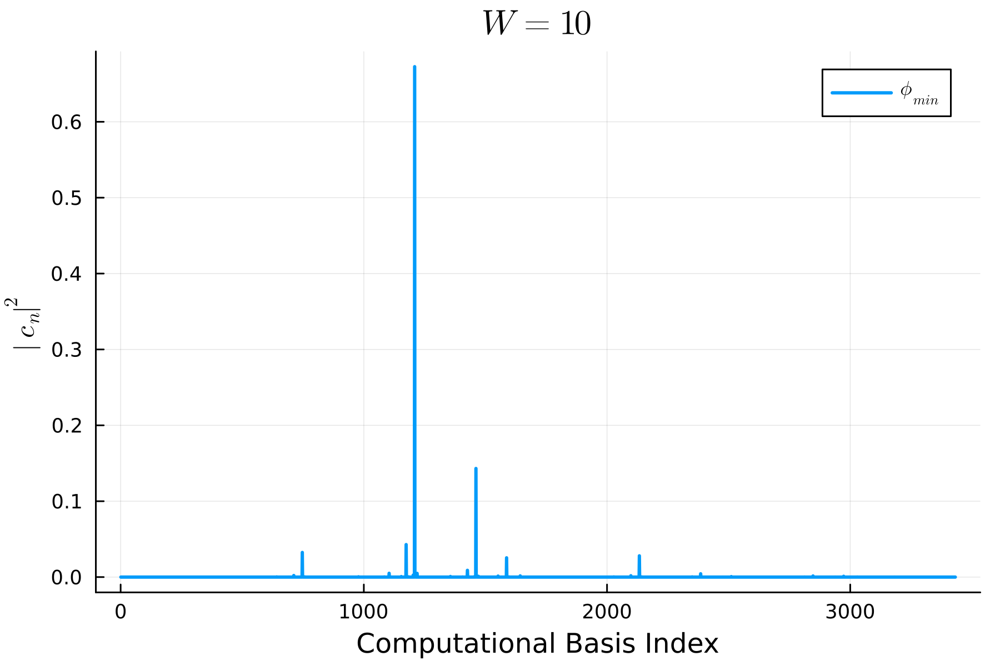

"/Users/jessica/git/Square-Spin-Ice/New code/computational_basis_weights.png"

In [47]:
# in the basis of eigenvectors
# eigenvectors: rows: comp basis, col: eigenbasis
# eigenvectors_1 : each entry is eigenbasis
the_W=string(W)
p=plot(abs2.(eigtemp.vectors[:, 265]), linewidth=2, xlabel="Computational Basis Index", ylabel=L"|c_n|^2", dpi=300, title=L"W=%$the_W", label=L"\phi_{min}")
display(p)
savefig("computational_basis_weights.png")

In [853]:
println(findall(abs2.((eigenvectors_1[:,1])) .> 0.05))

[372, 377, 390, 394]


In [852]:
println(findall(abs2.((eigenvectors_1[:,end])) .> 0.05))

[531, 535, 548, 553]


In [494]:
inverted_dict[804]

1-element Vector{Int64}:
 3384

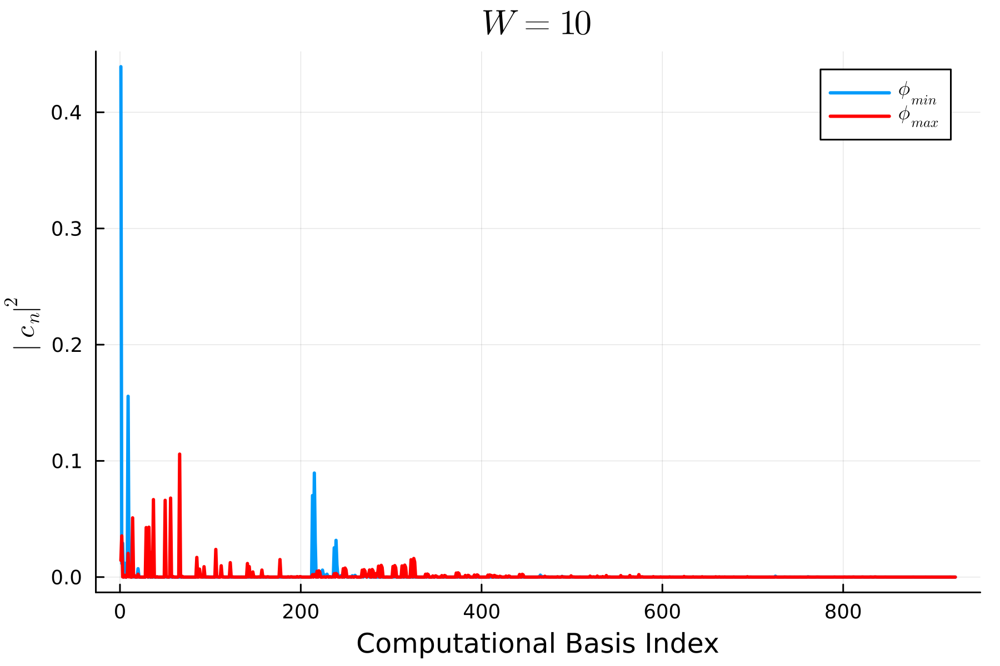

In [918]:
#  (265, 266)
the_W=string(W)
p=plot(abs2.(eigtemp.vectors*(vecs[1])), linewidth=2, xlabel="Computational Basis Index", ylabel=L"|c_n|^2", dpi=300, title=L"W=%$the_W", label=L"\phi_{min}")
plot!(p, abs2.(eigtemp.vectors*(the_max_state)), linewidth=2, ylabel=L"|c_n|^2", dpi=300, color="red", label=L"\phi_{max}")

display(p)

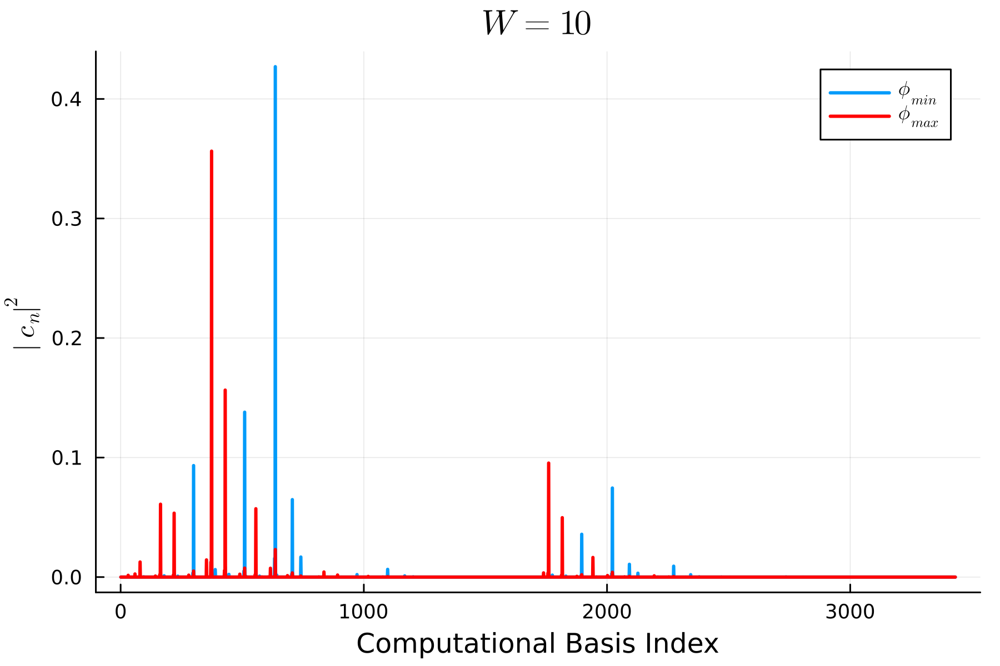

"/Users/jessica/git/Square-Spin-Ice/New code/computational_basis_weights.png"

In [48]:
#  (265, 266)
the_W=string(W)
p=plot(abs2.(eigtemp.vectors*(eigenvectors_1[:,1])), linewidth=2, xlabel="Computational Basis Index", ylabel=L"|c_n|^2", dpi=300, title=L"W=%$the_W", label=L"\phi_{min}")
plot!(p, abs2.(eigtemp.vectors*(eigenvectors_1[:,end])), linewidth=2, ylabel=L"|c_n|^2", dpi=300, color="red", label=L"\phi_{max}")

display(p)
savefig("computational_basis_weights.png")

In [49]:
println(findall(abs2.((eigenvectors_1[:,1])) .> 0.1))
println(findall(abs2.((eigenvectors_1[:,end])) .> 0.1))

[1615, 1616]
[1615, 1616]


# Find the computational basis states with the most weight in phi_min and phi_max

In [51]:
println(findall(abs2.(eigtemp.vectors*(eigenvectors_1[:,1])) .> 0.1))
println(findall(abs2.(eigtemp.vectors*(eigenvectors_1[:,end])) .> 0.1))

[510, 636]
[374, 430]


# Convert from the index of the comp basis state to its actual binary value

In [55]:
inverted_dict[430]

1-element Vector{Int64}:
 2675

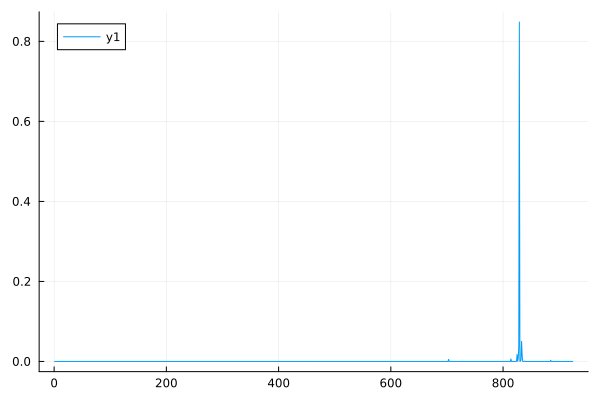

In [30]:
plot(abs2.(eigtemp.vectors[:,10]))

In [24]:
eigenvalues_1

924-element Vector{Float64}:
 -0.17233214133568528
 -0.17233201329172976
 -0.17233165479213874
 -0.17233099915364902
 -0.17232890697967804
 -0.17232854848010196
 -0.17232842043614602
 -0.17232789284160102
 -0.17232776479764028
 -0.1723274062980608
 -0.17231676408445026
 -0.17231365777240715
 -0.17231352972844458
  ⋮
  0.1723136577724086
  0.17231676408444954
  0.17232740629805787
  0.1723277647976445
  0.17232789284160294
  0.17232842043613789
  0.172328548480096
  0.17232890697967385
  0.17233099915364916
  0.17233165479214313
  0.1723320132917248
  0.17233214133568103

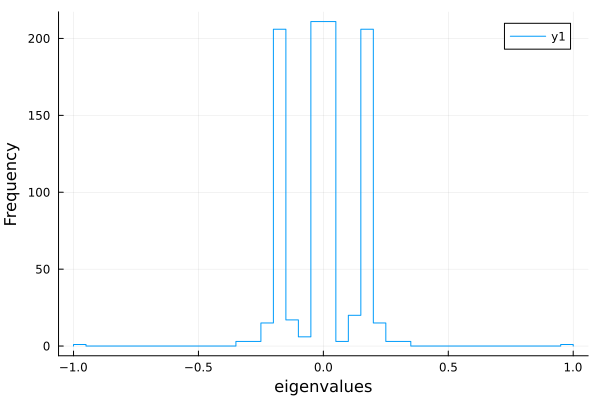

In [22]:
stephist(eigenvalues_1, xlabel="eigenvalues", ylabel="Frequency")

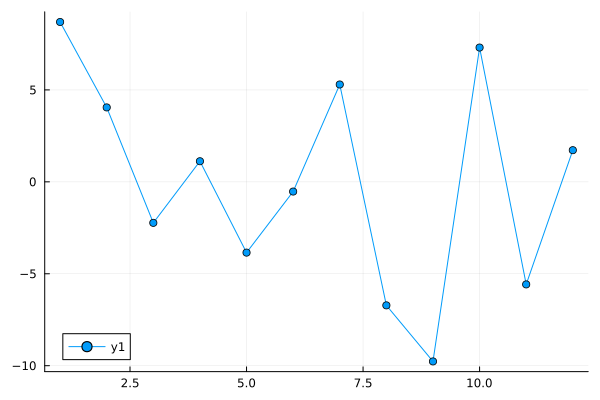

In [15]:
plot(h, marker=:circle)

In [5]:
println(h)

[8.833189469473034, -5.754644928339769, 2.694951387132949, -3.602494380494141, 7.117657723330614, 4.633177092557257, -6.520527255958579, -1.7473395287926485, 8.03485697810016, 5.477788406589797]


In [267]:
eigenstate_basis_interaction=eigenvectors'*interaction_half_filling*eigenvectors/0.1
diagonal_interaction_pieces=diag(eigenstate_basis_interaction)

924-element Vector{Float64}:
 2.0688504202616196
 2.8959958361676876
 2.0752472777913122
 2.936571315556561
 1.9910369787458837
 2.9435188028055648
 2.0796794320589984
 2.155522914226576
 2.0650907046834073
 2.891512421250924
 1.9666464948938647
 3.9645637233258144
 2.060296906368965
 ⋮
 2.9649236824738776
 1.0261534236305565
 2.891509289027339
 2.065073742349771
 1.1730158539815505
 1.0973533507918867
 2.9433381575169713
 1.0507062527562516
 1.9540815513344962
 2.075228977776391
 1.9136684172192955
 1.0863454882482095

# play around with disorder realizations

In [56]:
L= 14; # system size
T = 1 # random hopping strength
t = T*ones(Float64, L); #hopping
#t = ones(L)
W = 12; # disorder strength

all_eigenvalues=[]
all_eigenvalues_estimate=[]
anderson_energies=[]

theee_test=[]
deltah=0.01


all_ctc=[]
all_new_dctc=[]
all_old_dctc=[]

#for its=1:1
d=Uniform(-1,1)
h=W*rand(d, L)
all_Js=[]
the_map=construct_map_of_n_filling_states(L, div(L,2))

#h = [8.694759243319189, 4.048727976250208, -2.2304852869181713, 1.1214837906442532, -3.8489735509192236, -0.5274983921134879, 5.295366242356416, -6.718009358261026, -9.767422707014264, 7.304567074104924, -5.578244513530124, 1.7222883207391737]
h=[-7.705204989516603, 9.239748431267763, 0.2626763358145423, 4.917542125206225, 9.980130110385016, -6.0506974748261255, 5.628126322406805, 1.8531974453519307, -2.4206763512780483, -1.3420028048645816, -1.3158219470231591, 1.0587680474005556, 5.74868816786611, 1.2017084791551058]

#h=[9.546152730987004, 6.944271450174931, 8.561972625262456, -3.913919901458245, 6.308286232174735, -9.014759179085363, 0.5221822107962804, -8.829912922860128, 6.028943162145999, 0.220807462519077, 5.205733278283775, 9.731579821678602]
#h=[8.5067096178521, 0.6803539151062488, -9.200209220425556, -1.1683955921785327, -0.14596074210336596, -7.354471278000703, 2.60102322591675, 9.95890413942391, -1.2966959703103598, -0.3498409034598726, -1.653849900357629, 2.0834804551316277]

J_temp = 0.1*ones(Float64, L); # interactions

interaction_half_filling, trash=construct_interaction_nearest_neighbhor_half_filling(L, J_temp, the_map, false, "full")

    
the_map=construct_map_of_n_filling_states(L, div(L,2))

H_half_filling, max_index_half=construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, zeros(Float64, L), h, t,the_map, false, "full")

eigtemp=eigen(H_half_filling)
eigenvectors_anderson=eigtemp.vectors

eigenstate_basis_interaction=(eigenvectors_anderson'*interaction_half_filling*eigenvectors_anderson)/0.1
diagonal_interaction_pieces=diag(eigenstate_basis_interaction)

for i=0:200
#h[3]+=deltah
i_0=div(L,2)

J_mag=deltah*i
    push!(all_Js, J_mag)
J = J_mag*ones(Float64, L); # interactions

interaction_half_filling, trash=construct_interaction_nearest_neighbhor_half_filling(L, J_temp, the_map, false, "full")

the_map=construct_map_of_n_filling_states(L, div(L,2))

H_half_filling, max_index_half=construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, J, h, t,the_map, false, "full")

eigtemp=eigen(H_half_filling)
eigenvectors=eigtemp.vectors

push!(all_eigenvalues, eigtemp.values)
if(J_mag==0)
        anderson_energies=eigtemp.values
end

# the estimate for the eigenvalues
push!(all_eigenvalues_estimate, anderson_energies .+ J_mag .* diagonal_interaction_pieces)
N_R_nodiag=get_N_R_operator_eigenstate_basis(L, the_map, eigenvectors, div(L, 2))

#eigenvalues=eigen(N_R_nodiag'*N_R_nodiag).values
eigtemp_1=eigen(N_R_nodiag)
eigenvalues_1=eigtemp_1.values
eigenvectors_1=eigtemp_1.vectors
#println(sqrt(maximum(abs,eigenvalues)))
#println("CTC: ", (maximum(eigenvalues_1)-minimum(eigenvalues_1)))
push!(all_ctc, maximum(eigenvalues_1)-minimum(eigenvalues_1))

values, vecs1, info=eigsolve(N_R_nodiag, 1, :SR; ishermitian=true);
values_2, vecs, info=eigsolve(N_R_nodiag, 1, :LR; ishermitian=true);
#println("CTC 2:", values_2[1]-values[1])


N_R=get_N_L_operator(L,the_map, i_0)
N_R=eigenvectors'*N_R*eigenvectors

the_states=prepare_half_filling_state(eigenvectors, the_map, L, i_0)
v = abs.(the_states)           # |ψ|
A = abs.(N_R)                  # |N|
tmp = similar(v)               # workspace
mul!(tmp, A, v)                # tmp = A * v  (fast, BLAS / sparse matvec)
dynamical_upper_bound = dot(v, tmp)
#println("DCTC with original init state: ", dynamical_upper_bound)    
push!(all_old_dctc, dynamical_upper_bound)

#=
v = abs.(eigenvectors_1[:,end])           # |ψ|
A = abs.(N_R)                  # |N|
tmp = similar(v)               # workspace
mul!(tmp, A, v)                # tmp = A * v  (fast, BLAS / sparse matvec)
dynamical_upper_bound = dot(v, tmp) - eigenvectors_1[:,end]'*N_R*eigenvectors_1[:,end]
println("DCTC with diff init state: ", dynamical_upper_bound)   
=#

v = abs.(vecs[1])           # |ψ|
A = abs.(N_R)                  # |N|
tmp = similar(v)               # workspace
mul!(tmp, A, v)                # tmp = A * v  (fast, BLAS / sparse matvec)
dynamical_upper_bound = dot(v, tmp) - vecs[1]'*N_R*vecs[1]
#println("DCTC with diff init state 2: ", dynamical_upper_bound) 

push!(all_new_dctc, dynamical_upper_bound)

#println(sqrt(norm(N_R_nodiag)^2/(binomial(L, div(L,2)))))
#println(eigtemp.values)

N_R=eigtemp.vectors'*get_N_R_operator(L,the_map, div(L,2))*eigtemp.vectors;


#=
particle_number=[]
max_time=30000
for t=0:10:max_time
        time_evolved=time_evolve_state(vecs[1], eigtemp.values, t)
        number_particles_left=real(measure_number_particles_left_of_i_0(time_evolved, the_map,eigtemp.vectors, L, i_0))
        push!(particle_number, number_particles_left)
end

particle_number_2=[]

for t=0:10:max_time
        time_evolved=time_evolve_state(the_states, eigtemp.values, t)
        number_particles_left=real(measure_number_particles_left_of_i_0(time_evolved, the_map,eigtemp.vectors, L, i_0))
        push!(particle_number_2, number_particles_left)
end
    #stephist(real.(eigenvalues_1), bins=100, xlabel="Eigenvalue", ylabel="Frequency", label=false)
#end

=#
# get inverted map
inverted_dict = Dict{valtype(the_map), Vector{keytype(the_map)}}()

for (k, v) in the_map
    push!(get!(() -> valtype(inverted_dict)[], inverted_dict, v), k)
end
#println("next smallest ctc: "*string(eigenvalues_1[end-1]-eigenvalues_1[2]))
#print("overlap: ", dot(abs.(eigenvectors_1[:,end]), abs.(eigenvectors_1[:,1])))

# n_i configutration 1
exp_n_1=[vecs1[1]'*eigtemp.vectors'*get_n_i_operator_half_filling(i, L, the_map)*eigtemp.vectors*vecs1[1] for i=1:L]
# n_i configuration 2
exp_n=[vecs[1]'*eigtemp.vectors'*get_n_i_operator_half_filling(i, L, the_map)*eigtemp.vectors*vecs[1] for i=1:L]
delta_n=real.(exp_n)-real.(exp_n_1)

delta_n=real.(exp_n)-real.(exp_n_1)
total_mass_left=0
total_mass_right=0
center_of_mass_right=0
center_of_mass_left=0
for i=i_0+1:L
    center_of_mass_right+=(i-i_0)*abs(delta_n[i])
    total_mass_right+=abs(delta_n[i])
end

for i=1:i_0
    center_of_mass_left+=-(i_0-i)*abs(delta_n[i])
    total_mass_left+=abs(delta_n[i])
end
center_of_mass_left=center_of_mass_left/(total_mass_left)
center_of_mass_right=center_of_mass_right/(total_mass_right)

#if(abs(center_of_mass_right-center_of_mass_left)>50)
    #println("bad")
    #println(center_of_mass_left)
    #println(center_of_mass_right)
    #println(total_mass_left)
    #println(total_mass_right)
    #println(values_2[1]-values[1])
    #println("overlap: ", dot(abs.(eigenvectors_1[:,end]), abs.(eigenvectors_1[:,1])))
    #theee_test=delta_n
#end
end

transposed = collect.(zip(all_eigenvalues...))
println("lalala")
transposed_estimate = collect.(zip(all_eigenvalues_estimate...))
println("lalala")


lalala
lalala


In [1137]:
eigenvectors_anderson[:, 801]' * get_N_R_operator(L, the_map, i_0) * eigenvectors_anderson[:, 801]

4.972306138519396

In [1139]:
eigenvectors_anderson[:, 801]' * get_N_R_operator(L, the_map, i_0) * eigenvectors_anderson[:, 801]-eigenvectors_anderson[:, 808]' * get_N_R_operator(L, the_map, i_0) * eigenvectors_anderson[:, 808]

1.9452459488519591

# question: can we track where the computational basis states went?? hypothesis: the two resonating states happen to be very close to each other in the Anderson model, so they were more likely to be resonant

In [417]:
all_Js

201-element Vector{Any}:
 0.0
 0.01
 0.02
 0.03
 0.04
 0.05
 0.06
 0.07
 0.08
 0.09
 0.1
 0.11
 0.12
 ⋮
 1.8900000000000001
 1.9000000000000001
 1.9100000000000001
 1.92
 1.93
 1.94
 1.95
 1.96
 1.97
 1.98
 1.99
 2.0

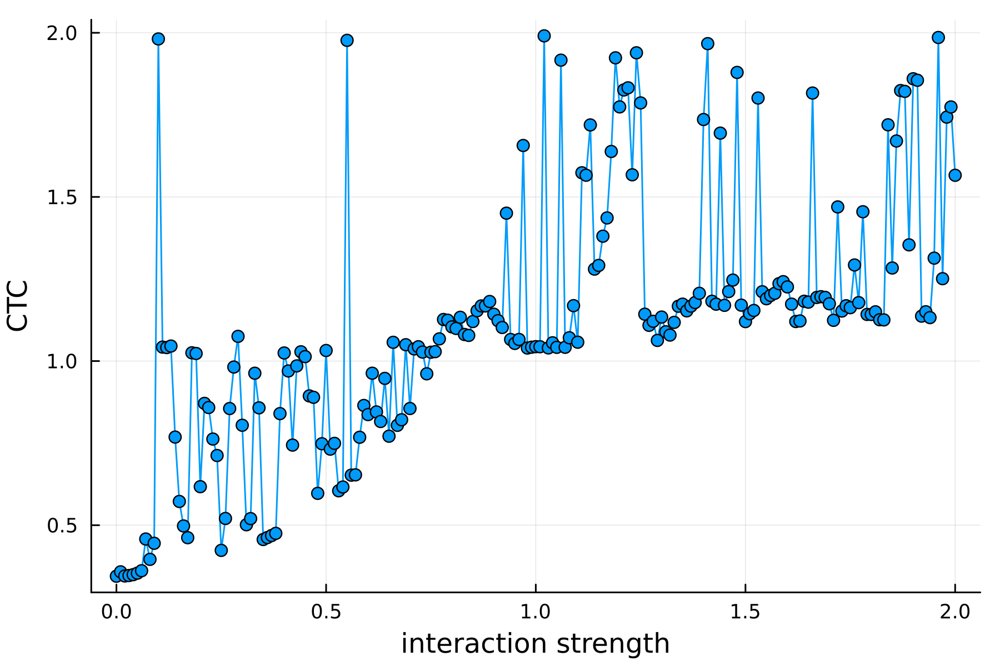

In [1147]:
plot(all_Js,all_ctc, marker=:circle, ylabel="CTC", label=false,xlabel="interaction strength", dpi=300)

In [592]:
transposed = collect.(zip(all_eigenvalues...))
println("lalala")
transposed_estimate = collect.(zip(all_eigenvalues_estimate...))
println("lalala")

lalala
lalala


In [1175]:
size(all_eigenvalues_estimate[1],1)

924

# calculate all matrix elements

In [1177]:
particles_transp=[]
off_diagonal_elem=[]
for i=1:size(eigenstate_basis_interaction,1)
    for j=i+1:size(eigenstate_basis_interaction,1)
        particles_transported=abs(eigenvectors_anderson[:, i]' * N_R_comp * eigenvectors_anderson[:, i]-eigenvectors_anderson[:, j]' * N_R_comp * eigenvectors_anderson[:, j])
        push!(particles_transp,particles_transported)
        push!(off_diagonal_elem,eigenstate_basis_interaction[i, j])
    end
end

In [1278]:
findall(x -> 0 .< x &&  x.< 1,particles_transp)

266924-element Vector{Int64}:
      1
      2
      3
      4
      5
      6
      7
      8
      9
     10
     11
     12
     13
      ⋮
 426414
 426416
 426417
 426418
 426419
 426420
 426421
 426422
 426423
 426424
 426425
 426426

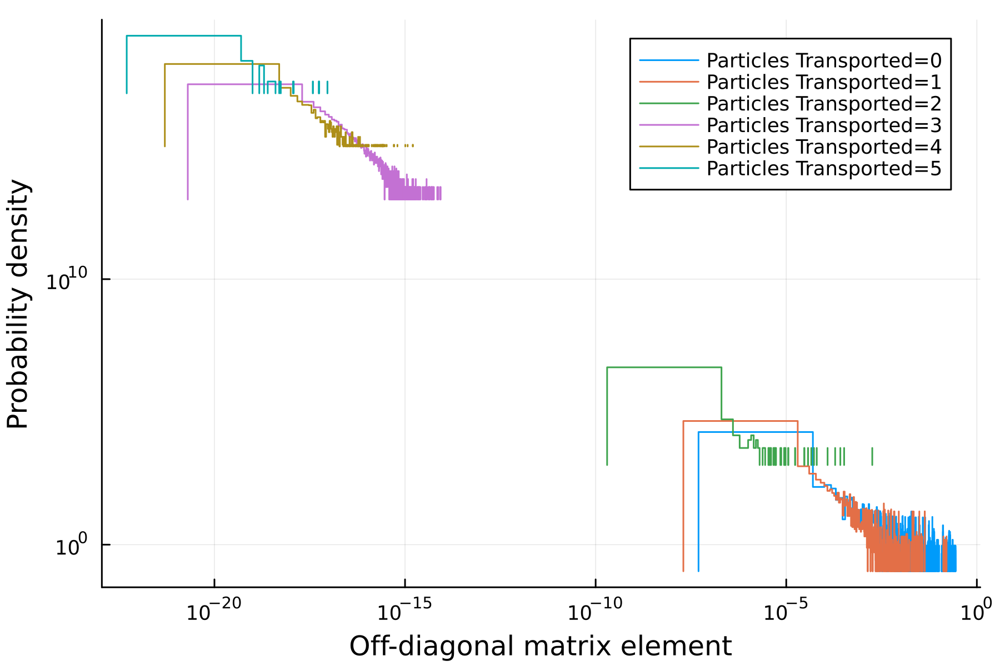

In [1293]:
p=plot()
for i=0:5
    indices=findall(x-> max(0,i-0.5) .< x &&  x.< i+0.5, abs.(particles_transp))
    stephist!(p,abs.(off_diagonal_elem[indices]), label="Particles Transported="*string(i), norm=true, yaxis=:log, xaxis=:log, ylabel="Probability density", xlabel="Off-diagonal matrix element")
end
display(p)

In [1159]:
N_R_comp=get_N_R_operator(L, the_map, i_0)
all_pos_resonances=[]
all_pos_particles_transported=[]
epsilon=1e-4
# each a is for a particular J
for a in all_eigenvalues_estimate
    pos_resonances=[]
    pos_particles_transported=[]
    for i=1:length(a)
        for j=i+1:length(a)
            if(abs(a[i]-a[j])<=2*abs(eigenstate_basis_interaction[i, j]))
                particles_transported=abs(eigenvectors_anderson[:, i]' * N_R_comp * eigenvectors_anderson[:, i]-eigenvectors_anderson[:, j]' * N_R_comp * eigenvectors_anderson[:, j])
                push!(pos_resonances, (i, j))
                push!(pos_particles_transported, particles_transported)
            end
            
        end
    end
    push!(all_pos_resonances, pos_resonances)
    push!(all_pos_particles_transported, pos_particles_transported)
end

In [1160]:
num_resonances=[]
max_particles_transported=[]
for a in all_pos_resonances
    push!(num_resonances, length(a))
end

for a in all_pos_particles_transported
    if(a!=[])
        push!(max_particles_transported, maximum(a))
    else
        push!(max_particles_transported, 0)
    end
end

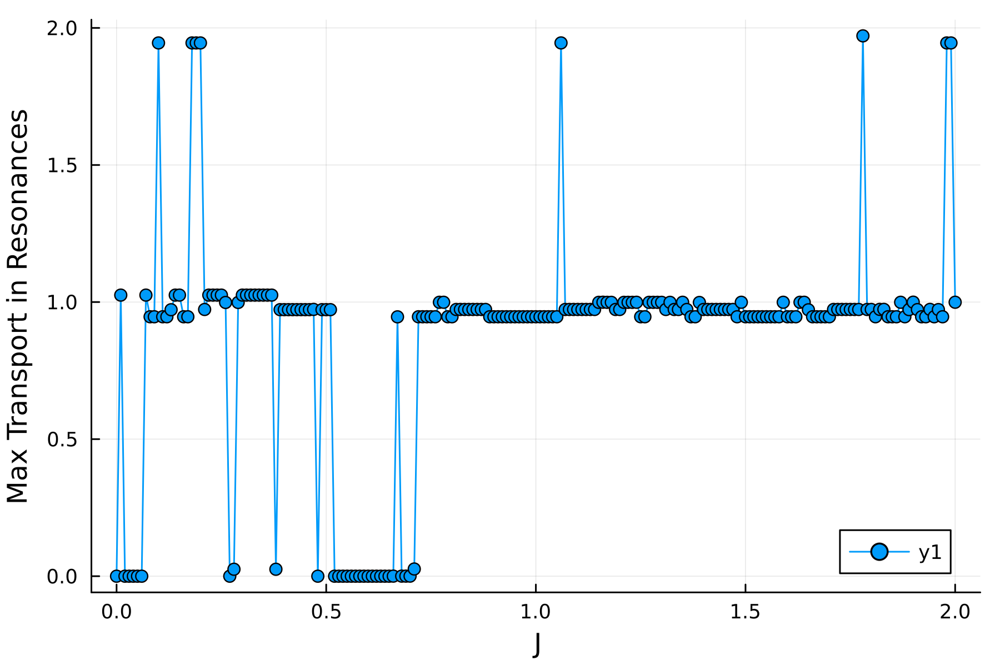

In [1181]:
plot(all_Js,max_particles_transported, ylabel="Max Transport in Resonances", xlabel="J", marker=:circle)

In [1122]:
all_pos_resonances[11]

15-element Vector{Any}:
 (102, 105)
 (285, 289)
 (427, 430)
 (465, 471)
 (510, 516)
 (541, 549)
 (586, 593)
 (612, 615)
 (656, 660)
 (743, 746)
 (801, 808)
 (810, 812)
 (832, 836)
 (875, 878)
 (894, 896)

In [1120]:
eigenstate_basis_interaction[801, 808]

-0.00033014157493151466

In [1107]:
all_pos_resonances_2=[]
epsilon=1e-4
# each a is for a particular J
for a in all_eigenvalues
    pos_resonances=[]
    for i=1:length(a)
        for j=i+1:length(a)
            if(abs(a[i]-a[j])<=epsilon)
                push!(pos_resonances, (i, j))
            end
        end
    end
    push!(all_pos_resonances_2, pos_resonances)
end
num_resonances_2=[]
for a in all_pos_resonances_2
    push!(num_resonances_2, length(a))
end

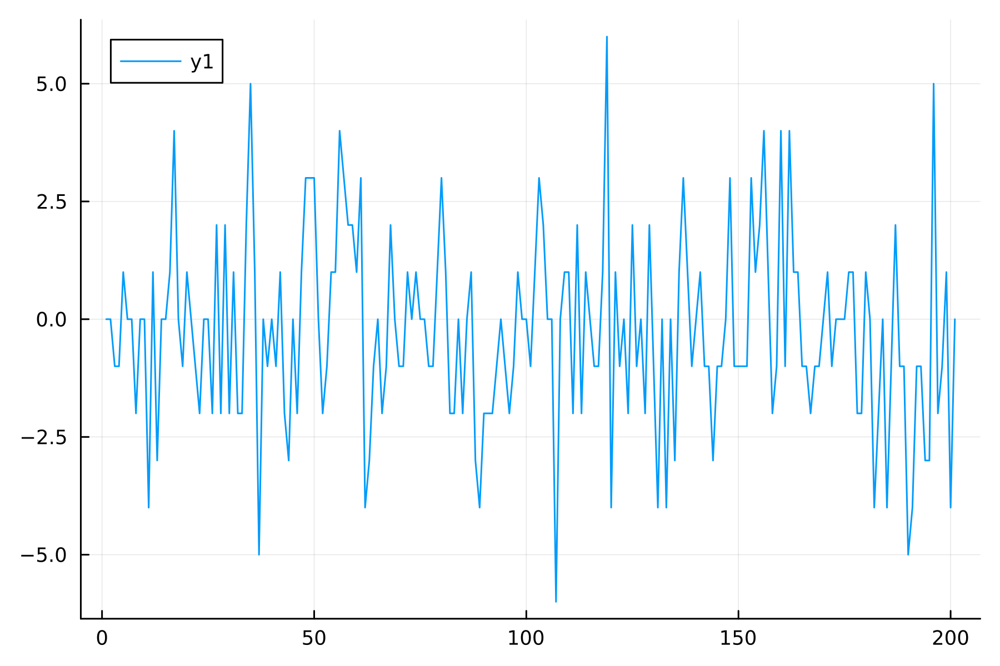

In [1111]:
plot(num_resonances_2 .- num_resonances)

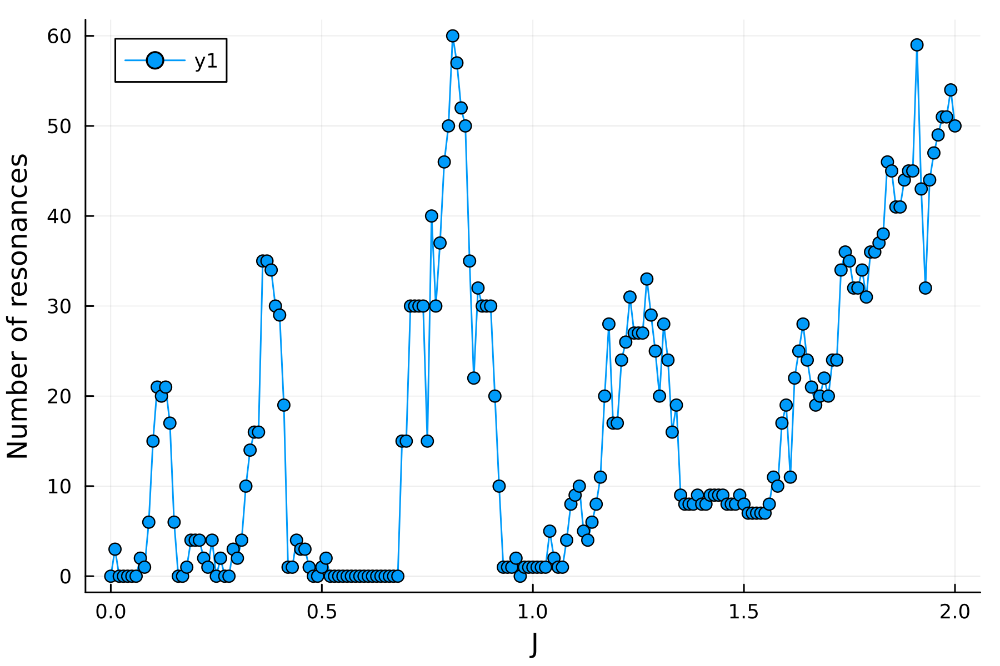

In [1130]:
plot(all_Js,num_resonances, xlabel="J", ylabel="Number of resonances", marker=:circle)

In [1129]:
num_resonances[11]

15

In [471]:
all_pos_resonances[11]

1-element Vector{Any}:
 (265, 266)

In [766]:
all_pos_resonances

201-element Vector{Any}:
 Any[]
 Any[(71, 72), (519, 520)]
 Any[]
 Any[(271, 272), (630, 631), (716, 717)]
 Any[(430, 431), (536, 537), (658, 659)]
 Any[(595, 596), (609, 610)]
 Any[(109, 110), (455, 456), (611, 612)]
 Any[]
 Any[(167, 168), (344, 345)]
 Any[(255, 256)]
 Any[(394, 395)]
 Any[]
 Any[]
 ⋮
 Any[(182, 183), (382, 383), (605, 606)]
 Any[(442, 443)]
 Any[(724, 725)]
 Any[(573, 574)]
 Any[(110, 111), (378, 379), (562, 563), (765, 766)]
 Any[(623, 624)]
 Any[(397, 398), (427, 428), (588, 589)]
 Any[(14, 15), (322, 323), (353, 354)]
 Any[(683, 684)]
 Any[(189, 190)]
 Any[]
 Any[(324, 325)]

In [277]:
transposed_estimate[804]

201-element Vector{Float64}:
 11.614251316118319
 11.643689776811721
 11.673128237505125
 11.702566698198527
 11.73200515889193
 11.761443619585332
 11.790882080278736
 11.820320540972139
 11.849759001665541
 11.879197462358944
 11.908635923052348
 11.93807438374575
 11.967512844439153
  ⋮
 17.17812038717146
 17.207558847864863
 17.236997308558266
 17.266435769251668
 17.29587422994507
 17.325312690638476
 17.35475115133188
 17.38418961202528
 17.413628072718684
 17.443066533412086
 17.47250499410549
 17.50194345479889

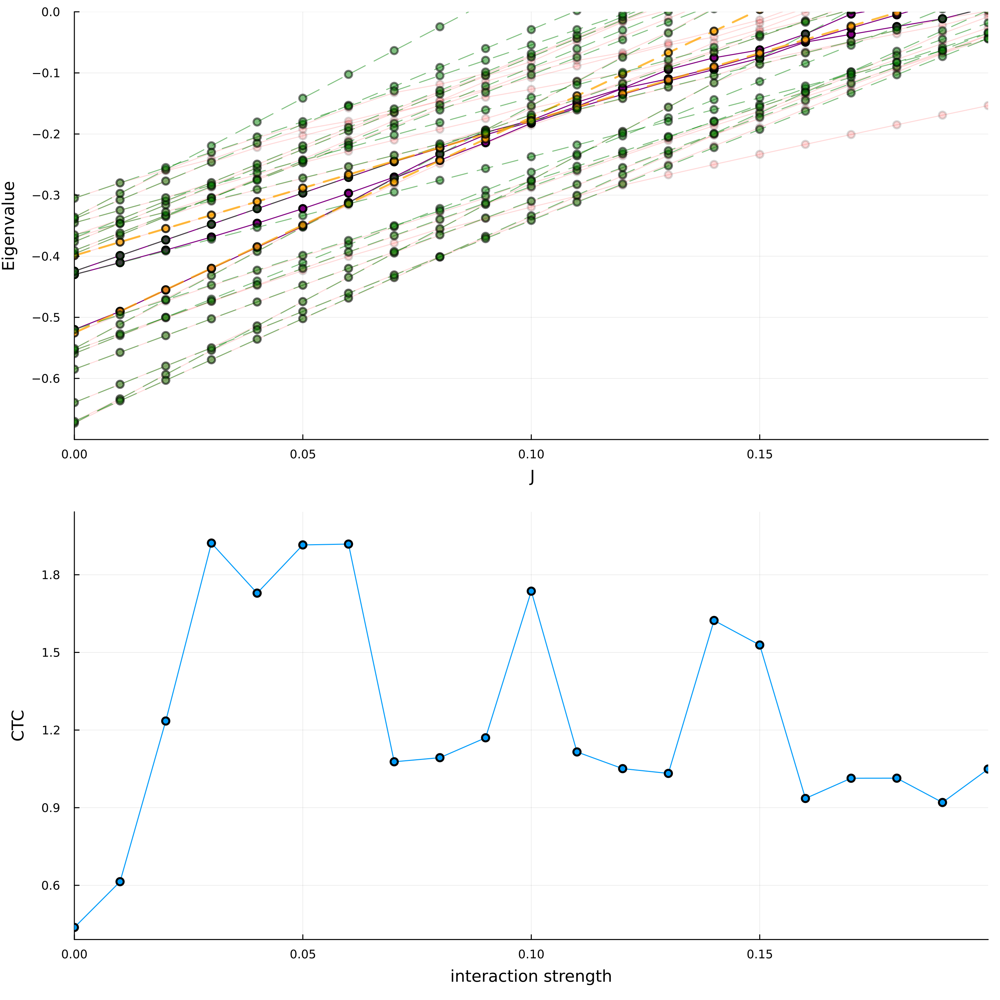

"/Users/jessica/git/Square-Spin-Ice/New code/level_crossings_plot.png"

In [901]:
eigenvalue_plot = plot(legend=false, xlabel="J", ylabel="Eigenvalue", yrange=(-0.7,0), xrange=(0,0.2))
counter=1
#[378, 379, 380]

for values in transposed
    if(370<=counter && counter <= 390)
    if(counter==378 || counter==379 || counter==380)
        plot!(eigenvalue_plot, all_Js, values, color=:purple, marker=:circle)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:red, alpha=0.15, marker=:circle)
    end
    end
    counter+=1
end



counter=1
for values in transposed_estimate
    if(370<=counter && counter <= 390)
    if(counter==381 || counter==377)
        plot!(eigenvalue_plot, all_Js, values, color=:orange, alpha=0.75, marker=:circle, linestyle=:dash, linewidth=2)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:green, alpha=0.5, linestyle=:dash, marker=:circle, label=L"E_n + J\langle|n|V_{diag}|n\rangle")
    end
    end
    counter+=1
end

p2=plot(all_Js,all_ctc, marker=:circle, ylabel="CTC", xlabel="interaction strength", dpi=300, xrange=(0,0.2), label=false)

p=plot(eigenvalue_plot, p2, layout = grid(2,1), link = :x, size=(1000,1000), dpi=300)
display(p)
savefig(p, "level_crossings_plot.png")

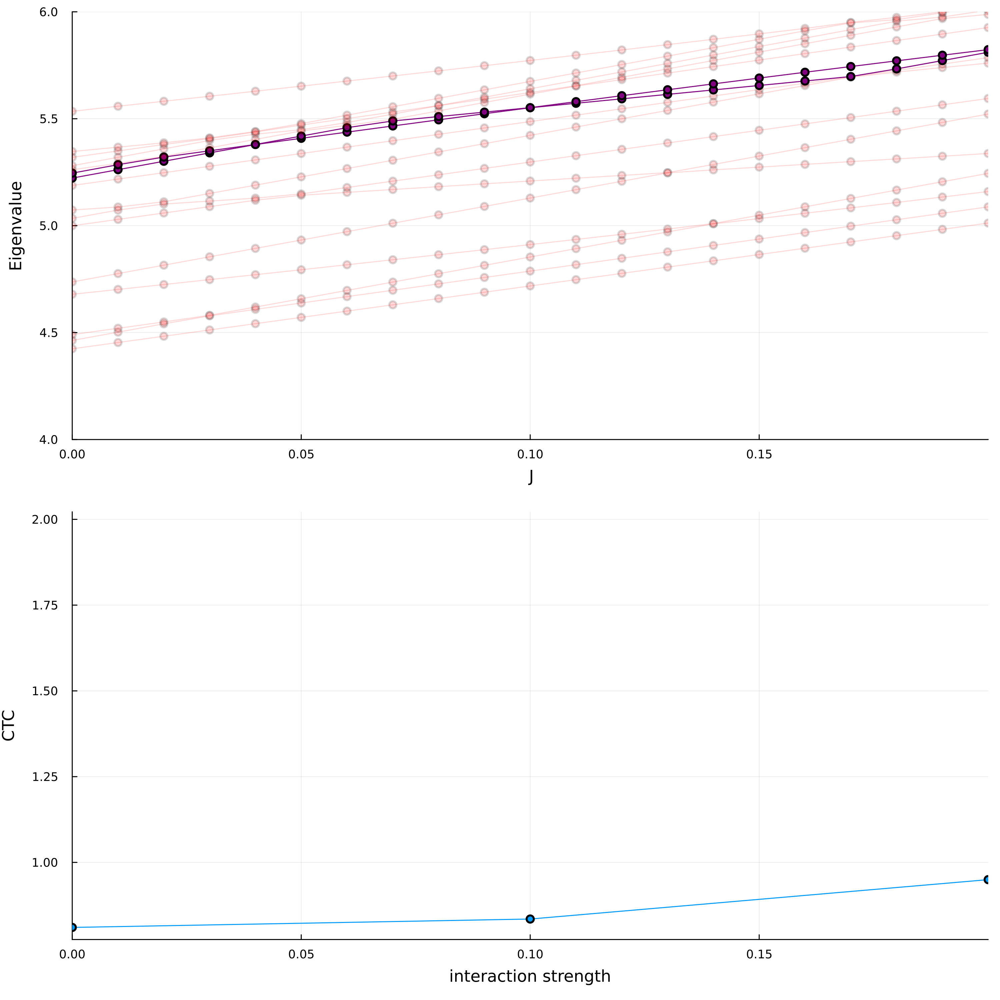

"/Users/jessica/git/Square-Spin-Ice/New code/level_crossings_plot.png"

In [850]:
eigenvalue_plot = plot(legend=false, xlabel="J", ylabel="Eigenvalue", yrange=(4,6), xrange=(0,0.2))
counter=1
# 185, 189, 190
for values in transposed
    if(180<=counter && counter <= 195)
    if(counter==189 || counter==190)
        plot!(eigenvalue_plot, all_Js, values, color=:purple, marker=:circle)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:red, alpha=0.15, marker=:circle)
    end
    end
    counter+=1
end

p2=plot(0:deltah:200*deltah,all_ctc, marker=:circle, ylabel="CTC", xlabel="interaction strength", dpi=300, xrange=(0,0.2), label=false)

p=plot(eigenvalue_plot, p2, layout = grid(2,1), link = :x, size=(1000,1000), dpi=300)
display(p)
savefig(p, "level_crossings_plot.png")

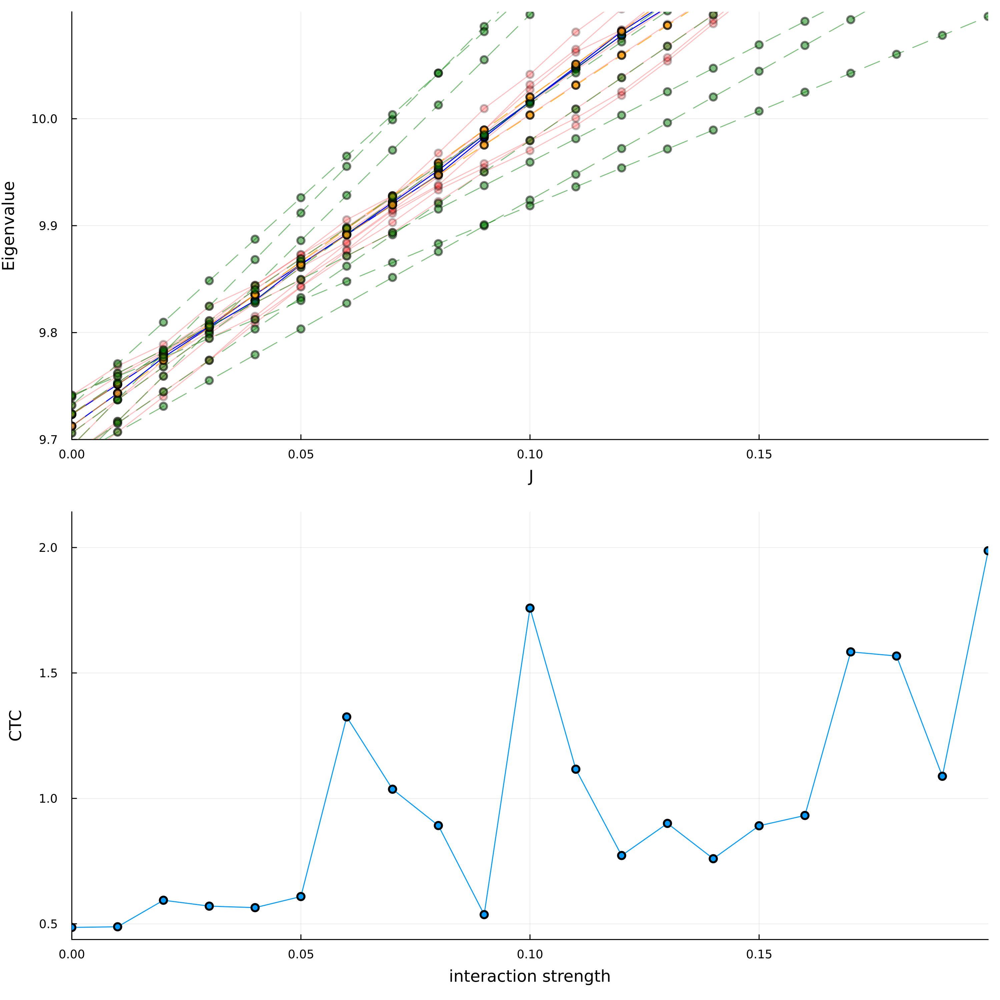

"/Users/jessica/git/Square-Spin-Ice/New code/level_crossings_plot.png"

In [67]:
# NEW!!

eigenvalue_plot = plot(legend=false, xlabel="J", ylabel="Eigenvalue", xrange=(0,0.2), yrange=(9.7,10.1))
counter=1

for values in transposed
    if(1610<=counter && counter <= 1620)
    if(counter==1615 || counter==1616)
        plot!(eigenvalue_plot, all_Js, values, color=:blue, marker=:circle)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:red, alpha=0.25, marker=:circle)
    end
    end
    counter+=1
end

counter=1
for values in transposed_estimate
    if(1610<=counter && counter <= 1620)
    if(counter==1615 || counter==1616)
        plot!(eigenvalue_plot, all_Js, values, color=:orange, alpha=0.75, marker=:circle, linestyle=:dash)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:green, alpha=0.5, linestyle=:dash, marker=:circle, label=L"E_n + J\langle|n|V_{diag}|n\rangle")
    end
    end
    counter+=1
end

p2=plot(all_Js,all_ctc, marker=:circle, ylabel="CTC", xlabel="interaction strength", dpi=300, xrange=(0,0.2), label=false)

p=plot(eigenvalue_plot, p2, layout = grid(2,1), link = :x, size=(1000,1000), dpi=300)
display(p)
savefig(p, "level_crossings_plot.png")

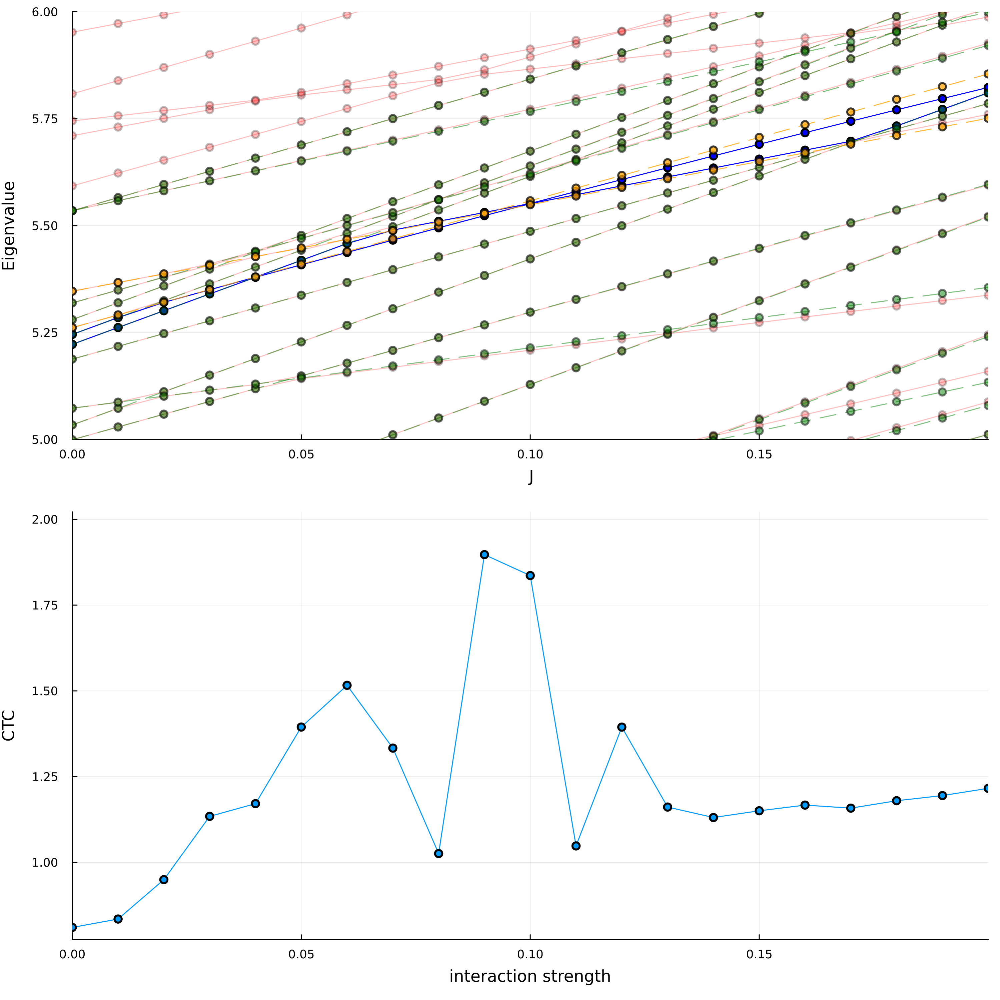

"/Users/jessica/git/Square-Spin-Ice/New code/level_crossings_plot.png"

In [884]:
eigenvalue_plot = plot(legend=false, xlabel="J", ylabel="Eigenvalue", yrange=(5,6), xrange=(0,0.2))
counter=1

for values in transposed
    if(180<=counter && counter <= 210)
    if(counter==189 || counter==190)
        plot!(eigenvalue_plot, all_Js, values, color=:blue, marker=:circle)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:red, alpha=0.25, marker=:circle)
    end
    end
    counter+=1
end

counter=1
for values in transposed_estimate
    if(180<=counter && counter <= 196)
    if(counter==191 || counter==194)
        plot!(eigenvalue_plot, all_Js, values, color=:orange, alpha=0.75, marker=:circle, linestyle=:dash)
    else
        plot!(eigenvalue_plot, all_Js, values, color=:green, alpha=0.5, linestyle=:dash, marker=:circle, label=L"E_n + J\langle|n|V_{diag}|n\rangle")
    end
    end
    counter+=1
end

p2=plot(all_Js,all_ctc, marker=:circle, ylabel="CTC", xlabel="interaction strength", dpi=300, xrange=(0,0.2), label=false)

p=plot(eigenvalue_plot, p2, layout = grid(2,1), link = :x, size=(1000,1000), dpi=300)
display(p)
savefig(p, "level_crossings_plot.png")

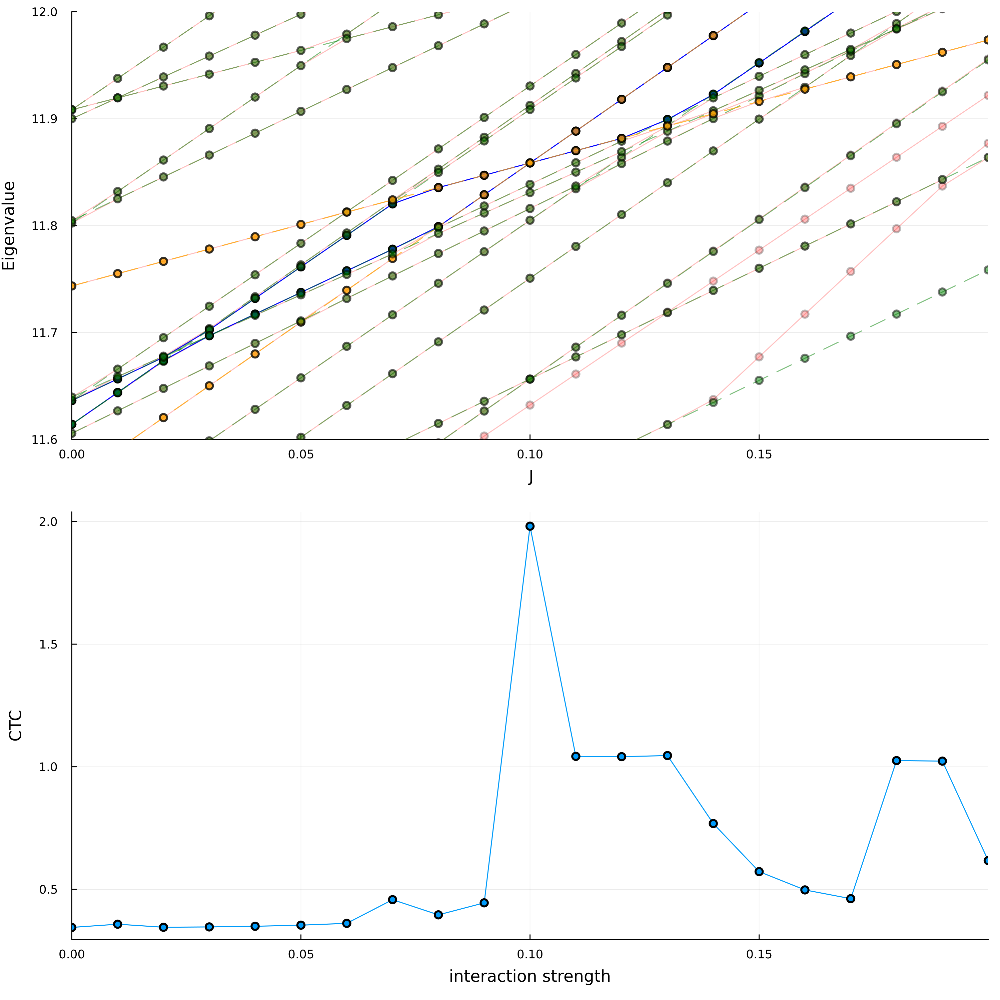

"/Users/jessica/git/Square-Spin-Ice/New code/level_crossings_plot.png"

In [1095]:
eigenvalue_plot = plot(legend=false, xlabel="J", ylabel="Eigenvalue", xrange=(0,0.2), yrange=(11.6,12))
counter=1

for values in transposed
    if(795<=counter && counter <= 815)
    if(counter==804 || counter==805)
        plot!(eigenvalue_plot, 0:deltah:200*deltah, values, color=:blue, marker=:circle)
    else
        plot!(eigenvalue_plot, 0:deltah:200*deltah, values, color=:red, alpha=0.25, marker=:circle)
    end
    end
    counter+=1
end

counter=1
for values in transposed_estimate
    if(795<=counter && counter <= 815)
    if(counter==801 || counter==808)
        plot!(eigenvalue_plot, 0:deltah:200*deltah, values, color=:orange, alpha=0.75, marker=:circle, linestyle=:dash)
    else
        plot!(eigenvalue_plot, 0:deltah:200*deltah, values, color=:green, alpha=0.5, linestyle=:dash, marker=:circle, label=L"E_n + J\langle|n|V_{diag}|n\rangle")
    end
    end
    counter+=1
end

p2=plot(0:deltah:200*deltah,all_ctc, marker=:circle, ylabel="CTC", xlabel="interaction strength", dpi=300, xrange=(0,0.2), label=false)

p=plot(eigenvalue_plot, p2, layout = grid(2,1), link = :x, size=(1000,1000), dpi=300)
display(p)
savefig(p, "level_crossings_plot.png")

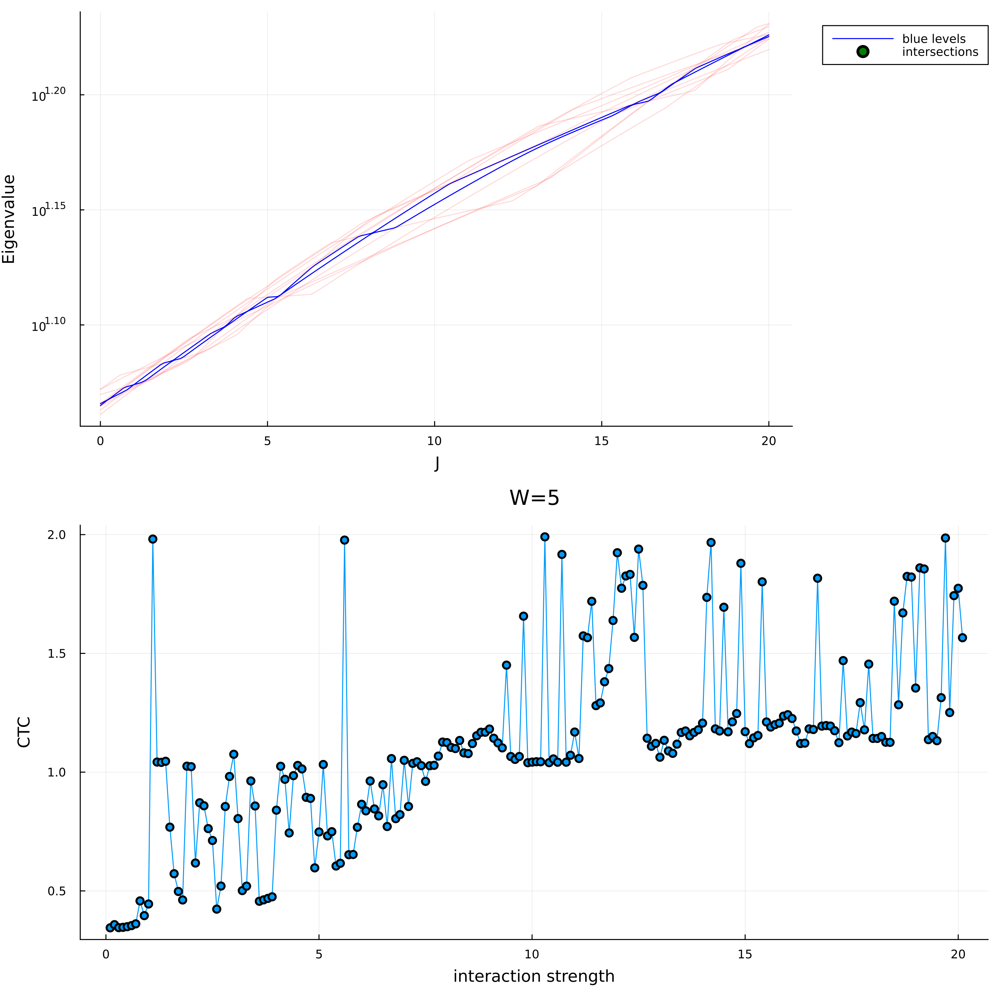

In [93]:
using Plots

# assume: transposed, all_ctc, deltah are already defined
Js = collect(0:deltah:200*deltah)

# turn tuples from `zip` into real vectors so we can index them easily
levels = [collect(v) for v in transposed]

plot_range = 800:810
blue_idxs  = [804, 805]

########################
# 1. Spaghetti plot
########################

eigenvalue_plot = plot(
    legend = :outertopright,
    xlabel = "J",
    ylabel = "Eigenvalue",
    yaxis  = :log
)

for idx in plot_range
    vals = levels[idx]
    if idx in blue_idxs
        plot!(eigenvalue_plot, Js, vals; color = :blue, label = idx == blue_idxs[1] ? "blue levels" : "")
    else
        plot!(eigenvalue_plot, Js, vals; color = :red, alpha = 0.15, label = "")
    end
end

########################
# 2. Find intersections with the blue levels
########################

xints = Float64[]
yints = Float64[]

for bi in blue_idxs
    yb = levels[bi]  # blue curve

    for idx in plot_range
        # skip the blue curves themselves
        if idx in blue_idxs
            continue
        end

        y = levels[idx]  # red curve

        # look for sign changes in (yb - y) between neighboring J points
        for k in 1:length(Js)-1
            diff1 = yb[k]   - y[k]
            diff2 = yb[k+1] - y[k+1]

            # exact hit at a grid point
            if diff1 == 0
                push!(xints, Js[k])
                push!(yints, yb[k])
            # sign change ⇒ crossing between Js[k] and Js[k+1]
            elseif diff1 * diff2 < 0
                dyb = yb[k+1] - yb[k]
                dy  = y[k+1]  - y[k]
                denom = dyb - dy

                # solve for t in yb[k] + t*dyb = y[k] + t*dy
                t = denom == 0 ? 0.5 : (y[k] - yb[k]) / denom
                t = clamp(t, 0.0, 1.0)

                x_int = Js[k] + t * (Js[k+1] - Js[k])
                y_int = yb[k] + t * dyb

                push!(xints, x_int)
                push!(yints, y_int)
            end
        end
    end
end

# add green markers at intersection points
scatter!(eigenvalue_plot, xints, yints;
         color = :green, marker = :circle, ms = 4,
         label = "intersections")

########################
# 3. CTC plot
########################

p2 = plot(
    deltah .* collect(1:length(all_ctc)),
    all_ctc;
    marker = :circle,
    ylabel = "CTC",
    xlabel = "interaction strength",
    dpi    = 300,
    title  = "W=5",
    legend = false
)

########################
# 4. Combine
########################

p = plot(eigenvalue_plot, p2, layout = grid(2,1), link = :x, size = (1000, 1000))
display(p)

In [453]:
abs.(transposed[189] .- transposed[190])

201-element Vector{Float64}:
 0.02316086654266769
 0.02325856692285644
 0.01959484610383555
 0.00969595629855391
 0.00032651354749457795
 0.010480829713281459
 0.02077567750889031
 0.023348956068812043
 0.015316041263696789
 0.007495023279549429
 0.0003913381553406481
 0.007518274945070402
 0.014668610076062016
 ⋮
 0.040098300520922336
 0.024862629842898443
 0.004853027056297421
 0.014235255178446593
 0.017696444579883064
 0.009841232923877286
 0.0019104603890145455
 0.006074207466671311
 0.014097166426473962
 0.022146773193746583
 0.03021413978656895
 0.03829233327690851

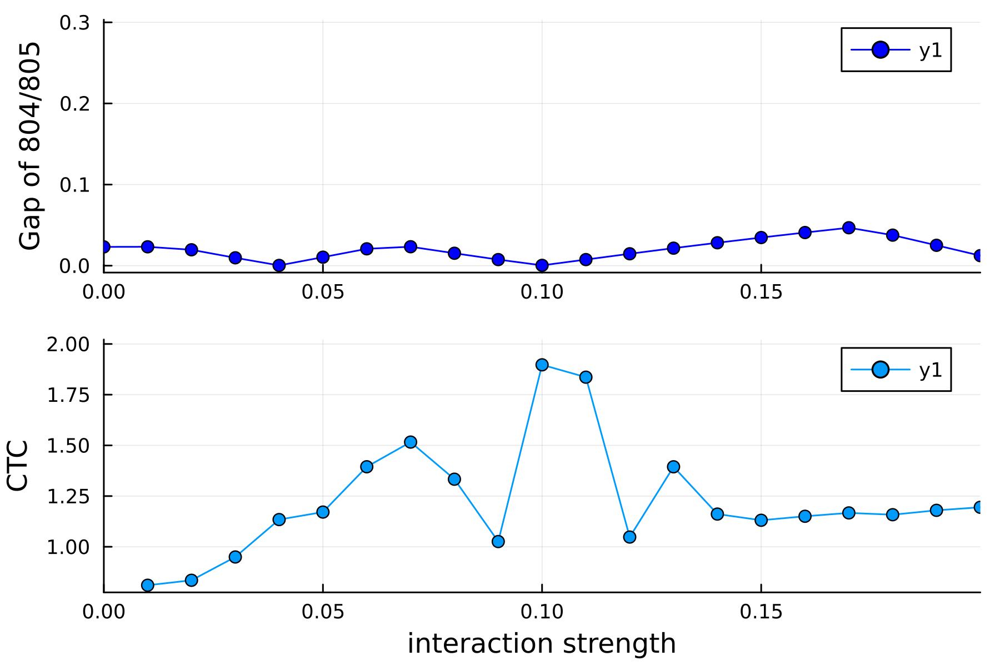

In [452]:
#eigenvalue_plot = plot(legend=:outertopright, xlabel="J", ylabel="Eigenvalue")
counter=1
pp=plot(0:deltah:200*deltah, abs.(transposed[189] .- transposed[190]), color=:blue, marker=:circle, ylabel="Gap of 804/805", xrange=(0,0.2))

p2=plot(0 .+ deltah .* collect(1:length(all_ctc)),all_ctc, marker=:circle, ylabel="CTC", xlabel="interaction strength", dpi=300,xrange=(0,0.2))

p=plot(pp, p2, layout = grid(2,1), link = :x)
display(p)

In [175]:
#x = [8.694759243319189, 4.048727976250208, -2.2304852869181713, 1.1214837906442532, -3.8489735509192236, -0.5274983921134879, 5.295366242356416, -6.718009358261026, -9.767422707014264, 7.304567074104924, -5.578244513530124, 1.7222883207391737]
ctcs=[]
agps=[]
for i=1:500
L=12

d=Uniform(-1,1)
x=10*rand(d, L)
t=1
pbc=false
bonds=bonds1D(L, pbc)
H=build_anderson_hamiltonian_1d(x, bonds, L, t)
eigtemp=eigen(Hermitian(H));
V=Array{Float64, 4}(build_Vijkl_matrix(eigtemp.vectors));
E, zero_indicies=build_energy_differences_matrix(eigtemp.values);
V[zero_indicies].=0;
W4=build_W_matrix_tensor_op(eigtemp.values, eigtemp.vectors, V, E);
AGP_norm=find_norm_operator(W4)
liom_corrections=[]
for i_0=1:L
    F1=find_norm_operator(calculate_f_from_w(W4, i_0))
    push!(liom_corrections, F1)
end

M=(transport_operator(eigtemp.vectors, eigtemp.values, i_0))
eigtemp_1=eigen(M)

ctc=sum(eigtemp_1.values[eigtemp_1.values.>0])-sum(eigtemp_1.values[eigtemp_1.values.<0])
#ctc=operator_norm(M)
    push!(ctcs, ctc)
    push!(agps, AGP_norm)
end

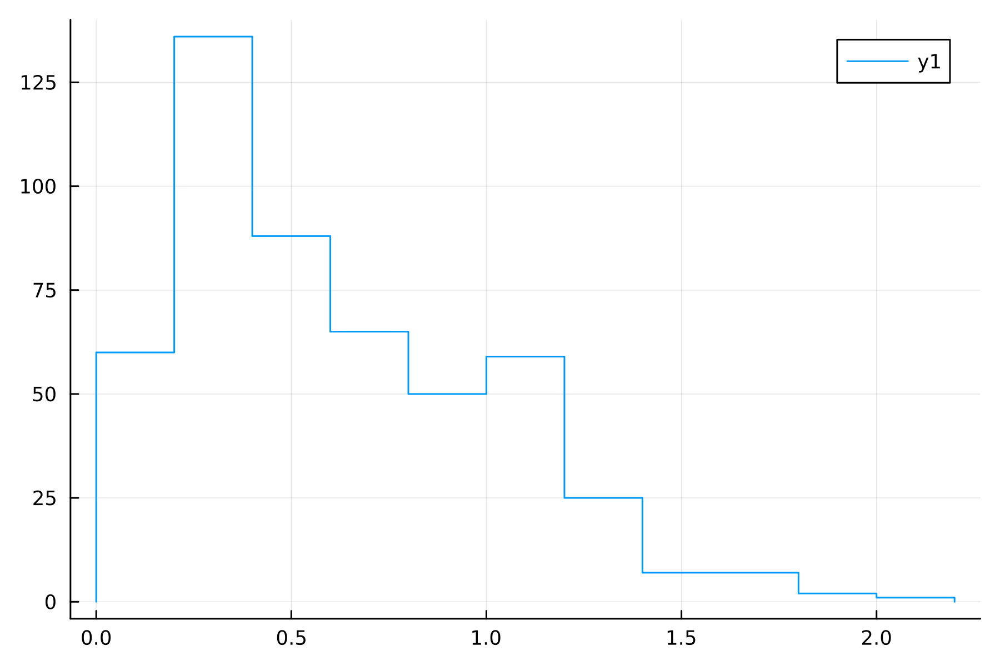

In [177]:
stephist(ctcs)

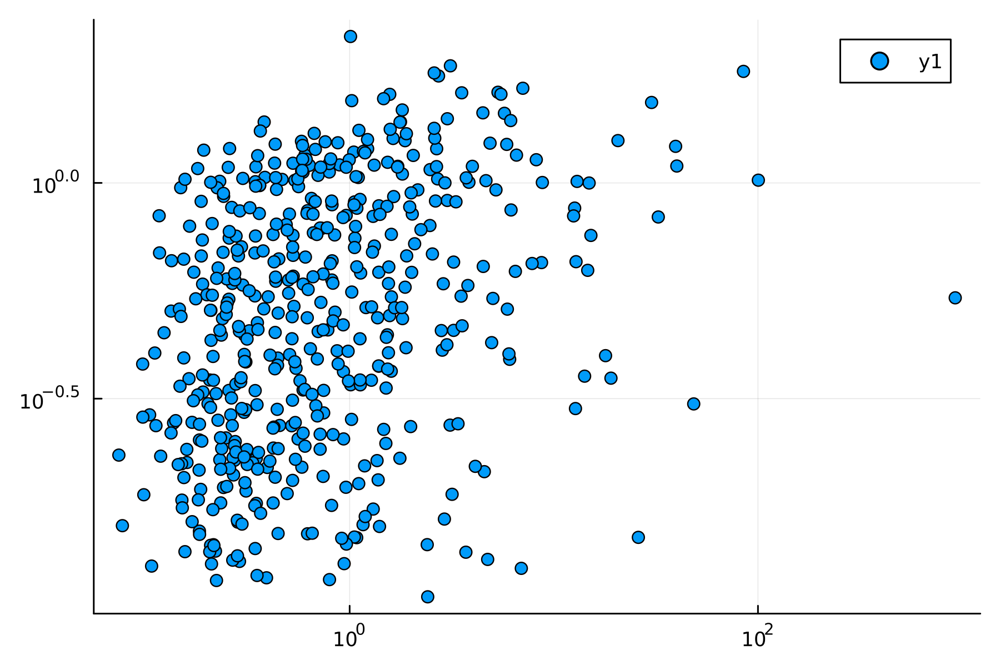

In [179]:
scatter(agps,ctcs, xaxis=:log, yaxis=:log)

In [165]:
println(x)

[-6.454503109533833, -7.243039375404368, 8.077289247837491, -4.031750984090978, 5.56119780895612, 5.985636588653007, 9.555315298415746, 3.956406685038465, 0.3962113031026826, -3.784057824942759, -1.6700359282710342, 3.018535806251319]


In [166]:
liom_corrections

12-element Vector{Any}:
 0.10499673895818125
 0.1061759686658504
 3.1873692204520134
 0.017431756867053626
 3.193484975076122
 3.193707827247355
 3.1867545084241047
 0.13614057275605929
 0.25549504007629864
 0.2386831565363446
 0.01755919617260409
 0.06606774804339455

2.8135976729905625

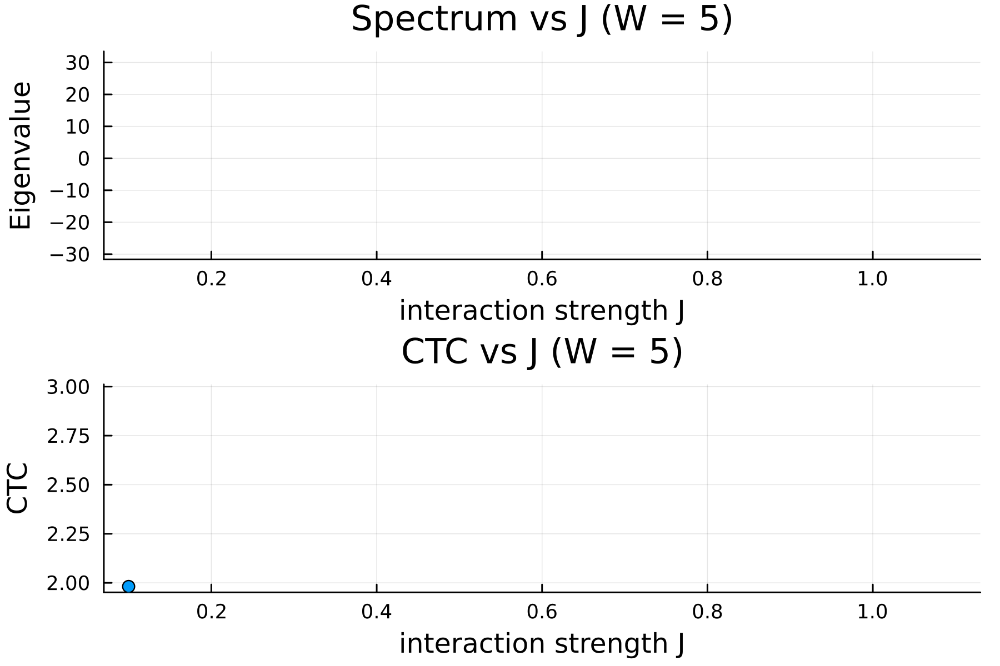

In [30]:
using Plots
default(dpi=300)

# J grid (x-axis)
N = length(all_ctc)
Js = deltah .* collect(1:N)  # or 0:deltah:(N-1)*deltah if that’s your convention

# Transpose eigenvalues so each element is one level traced over J
# all_eigenvalues[j] = eigenvalues at Js[j]
levels = collect.(zip(all_eigenvalues...))  # one entry per level index

########## Top: spaghetti (with faint background + highlighted subset) ##########
p1 = plot(
    xlabel = "interaction strength J",
    ylabel = "Eigenvalue",
    title  = "Spectrum vs J (W = 5)",
    legend = false
)

highlight_stride = 10  # highlight every 10th level

for (idx, vals_tuple) in enumerate(levels)
    vals = collect(vals_tuple)

    if (idx==804 || idx==805)
        # highlighted levels
        plot!(p1, Js, vals;
              color = :blue, lw = 1.5, alpha = 0.9)
    else
        # faint background
        plot!(p1, Js, vals;
              color = :gray, lw = 0.3, alpha = 0.15)
    end
end

########## Bottom: CTC vs J ##########
p2 = plot(
    Js, all_ctc;
    marker = :circle,
    xlabel = "interaction strength J",
    ylabel = "CTC",
    title  = "CTC vs J (W = 5)",
    legend = false
)

########## Optional: mark large-CTC regions on BOTH plots ##########
threshold = quantile(all_ctc, 0.9)  # top 10% of CTC values

for (j, J) in enumerate(Js)
    if all_ctc[j] > threshold
        vline!(p1, [J], c=:red, alpha=0.15, lw=1, lab="")
        vline!(p2, [J], c=:red, alpha=0.15, lw=1, lab="")
    end
end

plot(p1, p2, layout = grid(2,1), link = :x)


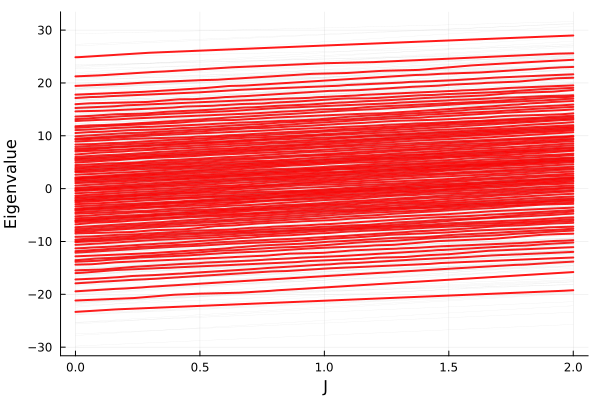

In [23]:
# assuming: all_eigenvalues :: Vector{Vector{Float64}}
# each element = eigenvalues at a given J
transposed = collect.(zip(all_eigenvalues...))  # one entry per level

# Build the J grid from the data instead of hardcoding 0:...:200*deltah
nJ = length(all_eigenvalues)
Js = range(0, step=deltah, length=nJ)

eigenvalue_plot = plot(
    xlabel = "J",
    ylabel = "Eigenvalue",
    legend = false
)

highlight_stride = 10  # highlight every 10th level

for (idx, vals_tuple) in enumerate(transposed)
    vals = collect(vals_tuple)  # turn tuple into Vector

    if idx % highlight_stride == 0
        # highlighted level
        plot!(eigenvalue_plot, Js, vals;
              color = :red, lw = 2, alpha = 0.9)
    else
        # faint background
        plot!(eigenvalue_plot, Js, vals;
              color = :gray, lw = 0.3, alpha = 0.15)
    end
end

display(eigenvalue_plot)


In [148]:
L= 10; # system size
T = 1 # random hopping strength
t = T*ones(Float64, L); #hopping
#t = ones(L)
W = 10; # disorder strength

theee_test=[]
deltah=0.1

all_new_dctc=[]
all_old_dctc=[]

for it=1:500

#for its=1:1
d=Uniform(-1,1)
h=W*rand(d, L)

#h = [8.694759243319189, 4.048727976250208, -2.2304852869181713, 1.1214837906442532, -3.8489735509192236, -0.5274983921134879, 5.295366242356416, -6.718009358261026, -9.767422707014264, 7.304567074104924, -5.578244513530124, 1.7222883207391737]
#h=[8.833189469473034, -5.754644928339769, 2.694951387132949, -3.602494380494141, 7.117657723330614, 4.633177092557257, -6.520527255958579, -1.7473395287926485, 8.03485697810016, 5.477788406589797, 0, 2]

i_0=div(L,2)

J_mag=0.1
J = J_mag*ones(Float64, L); # interactions



#J_temp = 0.1*ones(Float64, L); # interactions
#the_map=construct_map_of_n_filling_states(L, div(L,2))

#interaction_half_filling, trash=construct_interaction_nearest_neighbhor_half_filling(L, J_temp, the_map, false, "full")

H_half_filling, max_index_half=construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, J, h, t,the_map, false, "full")
eigtemp=eigen(H_half_filling)

eigenvectors=eigtemp.vectors
N_R_nodiag=get_N_R_operator_eigenstate_basis(L, the_map, eigenvectors, div(L, 2))

#eigenvalues=eigen(N_R_nodiag'*N_R_nodiag).values
eigtemp_1=eigen(N_R_nodiag)
eigenvalues_1=eigtemp_1.values
eigenvectors_1=eigtemp_1.vectors
#println(sqrt(maximum(abs,eigenvalues)))
#println("CTC: ", (maximum(eigenvalues_1)-minimum(eigenvalues_1)))

values, vecs1, info=eigsolve(N_R_nodiag, 1, :SR; ishermitian=true);
values_2, vecs, info=eigsolve(N_R_nodiag, 1, :LR; ishermitian=true);
ctc=values_2[1]-values[1]
if(ctc >=1.5)
        println("CTC: ", string(ctc))
        println(h)
        println()
end
end

CTC: 1.9341566184689598
[4.773120014010821, -4.576146755427386, -7.755932293192944, 2.9834289925603263, -7.808839923826598, 2.949129298448956, -1.689099912746801, -7.649396741162622, 1.262141393402052, -5.281996350747955]

CTC: 1.6590217673964425
[0.10904748080484916, 9.576039625309399, 2.121748436613251, -6.375660141067949, -4.9544505756348745, -3.4038160518674587, 7.584267256760704, -6.321994543259779, -4.750027008368781, -2.9064645959633784]

CTC: 2.0081449651182073
[8.327302653764395, -8.881506527171123, 4.720269497079535, 6.927933792084319, 7.600312903197215, 7.437719951763501, 7.498356031865687, -7.456995089690334, 0.8516614085420571, 0.984007993909839]

CTC: 2.056325744060278
[6.580598872161511, -7.74606298438083, -9.779405247972921, -3.9975754000663266, -2.578964000557671, -2.192483097586422, -6.024824209469568, -4.637465062871899, -1.1574452611712704, -4.450079217105813]

CTC: 1.71789462458927
[7.624559152953239, 5.635769968677373, 2.886563668926294, -6.825900769631781, 1.3964

LoadError: InterruptException:

In [367]:
L= 12; # system size
T = 1 # random hopping strength
t = T*ones(Float64, L); #hopping
#t = ones(L)
W = 10; # disorder strength

theee_test=[]

all_new_dctc=[]
all_old_dctc=[]

#for its=1:1
d=Uniform(-1,1)
h=[7.81492240382327, -5.074023133887073, 9.083482335292235, 8.275699280035338, -1.727538519667422, -4.477832140930347, -4.620953843517692, 6.749563970461596, -1.2418513023114075, 7.972783227280075, -4.6631263405551575, -2.050345452323632]
i_0=div(L,2)


J_mag=0
J = J_mag*ones(Float64, L); # interactions

the_map=construct_map_of_n_filling_states(L, div(L,2))

println(J)
println(h)

H_half_filling, max_index_half=construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, J, h, t,the_map, false, "full")
eigtemp=eigen(H_half_filling)

eigenvectors=eigtemp.vectors
N_R_nodiag=get_N_R_operator_eigenstate_basis(L, the_map, eigenvectors, div(L, 2))

#eigenvalues=eigen(N_R_nodiag'*N_R_nodiag).values
eigtemp_1=eigen(N_R_nodiag)
eigenvalues_1=eigtemp_1.values
eigenvectors_1=eigtemp_1.vectors
#println(sqrt(maximum(abs,eigenvalues)))
println("CTC: ", (maximum(eigenvalues_1)-minimum(eigenvalues_1)))

values, vecs1, info=eigsolve(N_R_nodiag, 1, :SR; ishermitian=true);
values_2, vecs, info=eigsolve(N_R_nodiag, 1, :LR; ishermitian=true);
println("CTC 2:", values_2[1]-values[1])

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[7.81492240382327, -5.074023133887073, 9.083482335292235, 8.275699280035338, -1.727538519667422, -4.477832140930347, -4.620953843517692, 6.749563970461596, -1.2418513023114075, 7.972783227280075, -4.6631263405551575, -2.050345452323632]
CTC: 1.9856567581118574
CTC 2:1.985656758111853


In [1069]:
L=12
t=1
x=[7.81492240382327, -5.074023133887073, 9.083482335292235, 8.275699280035338, -1.727538519667422, -4.477832140930347, -4.620953843517692, 6.749563970461596, -1.2418513023114075, 7.972783227280075, -4.6631263405551575, -2.050345452323632]
x=[2.683315876769259, 4.667619862829609, 6.180100594669627, 3.2510961951879502, 9.519737991475532, 6.05523158254625, 3.454993844597254, 5.336538953741956, -2.2327982191470097, 0.19602330524067346, -0.08624735953734808, 3.5640125376540865]

#x=10*rand(d, L)
#append!(x, reverse(copy(x)))
pbc=false
bonds=bonds1D(L, pbc)
H=build_anderson_hamiltonian_1d(x, bonds, L, t)
eigtemp=eigen(Hermitian(H));

M=(transport_operator(eigtemp.vectors, eigtemp.values, i_0))

eigtemp_1=eigen(M)

ctc=sum(eigtemp_1.values[eigtemp_1.values.>0])-sum(eigtemp_1.values[eigtemp_1.values.<0])
println(ctc)

1.9453022803053266


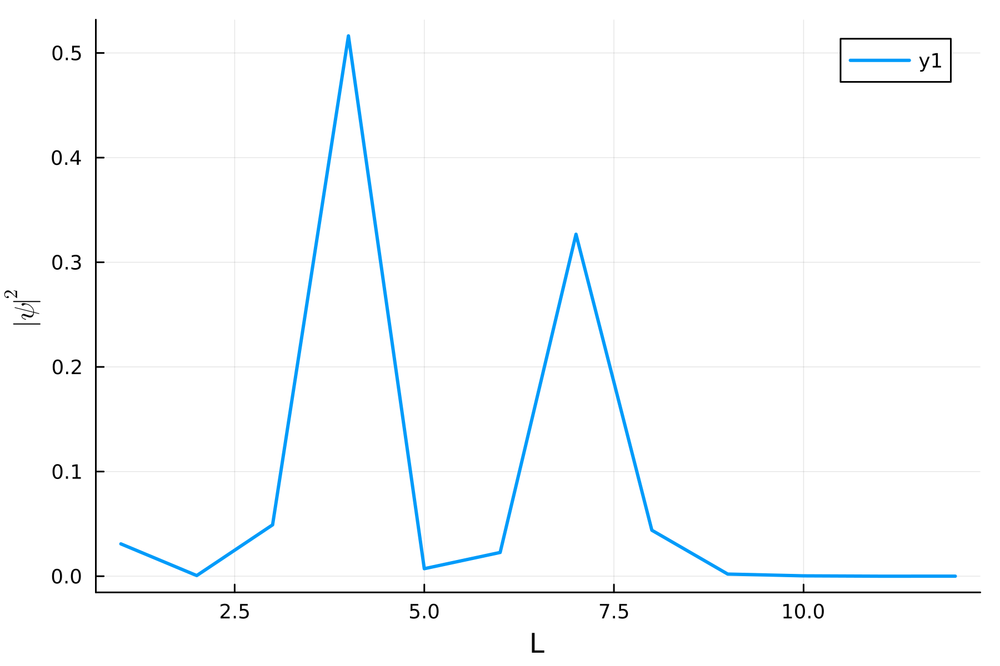

In [1078]:
plot(abs2.(eigtemp.vectors[:, 6]), ylabel=L"|\psi|^2", xlabel="L", linewidth=2)

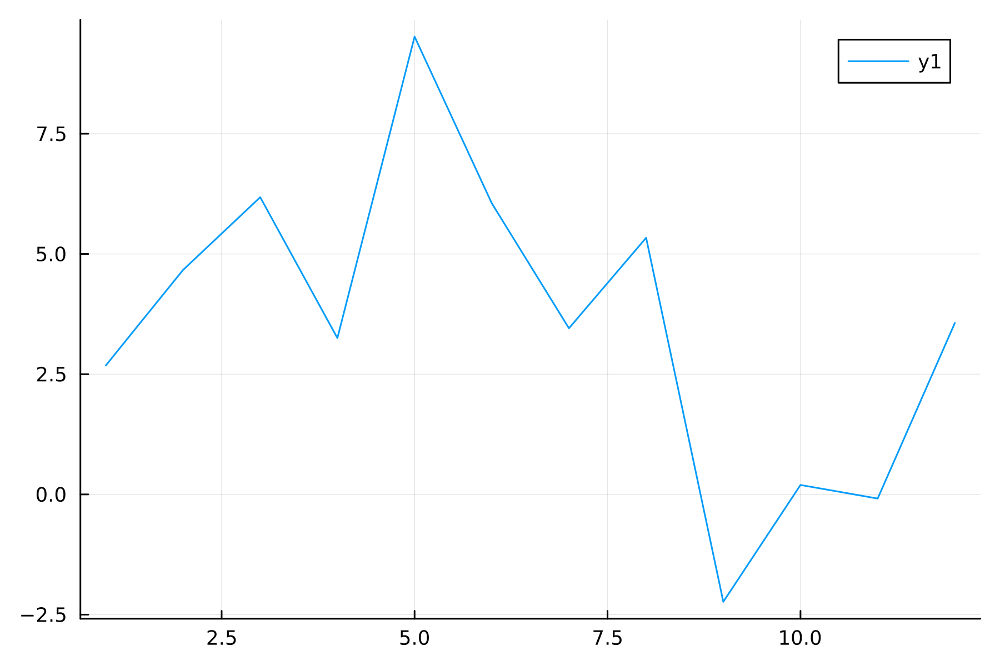

In [1068]:
plot(x)

# Objective is to run this and see how the real CTC trends with the estimated one

In [22]:

Ls=[14]
Ws=collect(range(start=4, stop=12, step=2))
#Ws=[10]
disorder_realizations=1
T=1 # random hopping strength
JJ=0.1

particles=[]
resonances=[]
ctc_all=[]

dctc_new_init=[]

phase=0
alpj=0.5
phases=range(0, stop=1/sqrt(2), length=2000)
the_norms=[]
for W in Ws
    println("W="*string(W))
    norms_W=[]
    norms_frobenius_W=[]
    DCTC_W=[]
    overlap_of_edge_states_W=[]
    dctc_new_init_W=[]
    com_W=[]
    mass_W=[]
    particles_W=[]
    resonances_W=[]

for L in Ls
    t = T*ones(Float64, L); #hopping
    println("L="*string(L))
    resonances_L=[]
    particles_L=[]
    norms_L=[]
    the_map=construct_map_of_n_filling_states(L, div(L,2))
    N_R_comp=get_N_R_operator(L, the_map, div(L,2))

    for i in phases
        t = T*ones(Float64, L); #hopping

        i_0=div(L,2)

        #t = ones(L)
        d=Uniform(-1,1)
        h = W*rand(d, L); 
        #h=2*v*cos.(2*pi*sqrt(2).*(xrange.+i)) ./ (1 .- alpj .* cos.(2*pi*sqrt(2).*(xrange.+phase)))

        J = JJ*ones(Float64, L);

        # LALALALALA
        
        J_temp = JJ*ones(Float64, L); # interactions
        
        interaction_half_filling, trash=construct_interaction_nearest_neighbhor_half_filling(L, J_temp, the_map, false, "full")
        
        H_half_filling, max_index_half=construct_disordered_interacting_hamiltonian_nearest_neighbor_half_filling(L, zeros(Float64, L), h, t,the_map, false, "full")

        eigtemp=eigen(H_half_filling)
        eigenvectors_anderson=eigtemp.vectors


        N_R=get_N_L_operator(L,the_map, i_0)
        N_R=eigenvectors_anderson'*N_R*eigenvectors_anderson
        N_R_nodiag=N_R-Diagonal(diag(N_R))
            
        values, vecs, info=eigsolve(N_R_nodiag, 1, :SR; ishermitian=true);
        values_2, vecs_2, info=eigsolve(N_R_nodiag, 1, :LR; ishermitian=true);
        
        ctc=(values_2[1]-values[1])
        push!(norms_L, ctc)
        eigenstate_basis_interaction=(eigenvectors_anderson'*interaction_half_filling*eigenvectors_anderson)/0.1
        diagonal_interaction_pieces=diag(eigenstate_basis_interaction)
        
        anderson_energies=eigtemp.values

        estimated_energies=anderson_energies .+ JJ .* diagonal_interaction_pieces

        all_pos_resonances=[]
        all_pos_particles_transported=[]
        epsilon=1e-4
        # each a is for a particular J
            pos_resonances=[]
            pos_particles_transported=[]
            for i=1:length(estimated_energies)
                for j=i+1:length(estimated_energies)
                    if(abs(estimated_energies[i]-estimated_energies[j])<=2*abs(eigenstate_basis_interaction[i, j]))
                        particles_transported=abs(eigenvectors_anderson[:, i]' * N_R_comp * eigenvectors_anderson[:, i]-eigenvectors_anderson[:, j]' * N_R_comp * eigenvectors_anderson[:, j])
                        push!(pos_resonances, (i, j))
                        push!(pos_particles_transported, particles_transported)
                    end
                    
                end
            end
            resonance_ctc=0
            if(pos_particles_transported!=[])          
                resonance_ctc=maximum(pos_particles_transported)
            end
            push!(particles_L, max(resonance_ctc, ctc))
            push!(resonances_L,length(pos_resonances))
    end
        push!(norms_W, norms_L)
        push!(particles_W, particles_L)
        push!(resonances_W, resonances_L)
end

    push!(particles, particles_W)
    push!(resonances, resonances_W)
end

save_object("1_14_M_resonances_small_W, J="*string(JJ)*", t="*string(T)*".jld2", resonances)
save_object("1_14_M_estimated_ctc_small_W, J="*string(JJ)*", t="*string(T)*".jld2", particles)
save_object("1_14_M_actual_ctc_small_W, J="*string(JJ)*", t="*string(T)*".jld2", ctc_all)

W=4
L=4
L=6
L=8
L=10
L=12
L=14
W=6
L=4
L=6
L=8
L=10
L=12
L=14
W=8
L=4
L=6
L=8
L=10
L=12
L=14
W=10
L=4
L=6
L=8
L=10
L=12
L=14
W=12
L=4
L=6
L=8
L=10
L=12
L=14


In [23]:
    save_object("1_9_M_resonances_small_W, J="*string(JJ)*", t="*string(T)*".jld2", resonances)
    save_object("1_9_M_estimated_ctc_small_W, J="*string(JJ)*", t="*string(T)*".jld2", particles)

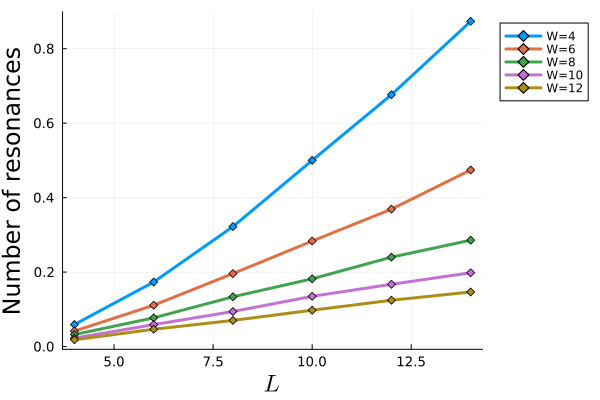

In [24]:
Ls=collect(range(start=4, stop=14, step=2))
p = plot(xlabel=L"L", ylabel="Number of resonances",
    xguidefontsize=16,
        yguidefontsize=16,
        titlefont=18,
        xtickfontsize=9,
        ytickfontsize=9,
legend=:outertopright)
        count1=1
count=1
for b in resonances
means=[]

the_count=1 
for a in b
    push!(means, mean(a)/binomial(Ls[the_count], div(Ls[the_count],2)))
        the_count+=1
end
    plot!(p,Ls, means,marker=:diamond, linewidth=3, label="W="*string(Ws[count]))
    count+=1
end
display(p)

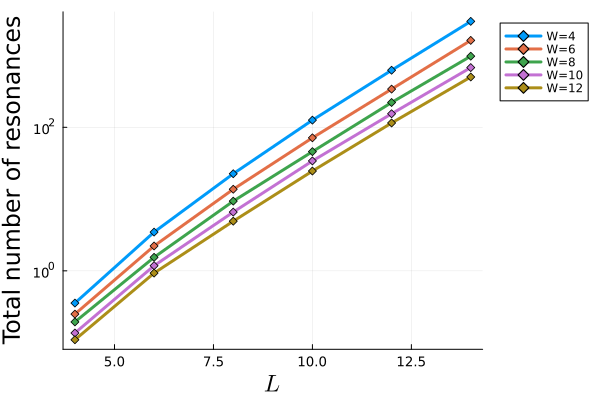

In [33]:
Ls=collect(range(start=4, stop=14, step=2))
p = plot(xlabel=L"L", ylabel="Total number of resonances",
    xguidefontsize=16,
        yguidefontsize=16,
        titlefont=18,
        xtickfontsize=9,
        ytickfontsize=9,
legend=:outertopright)
        count1=1
count=1
for b in resonances
means=[]

for a in b
    push!(means, mean(a))
end
    plot!(p,Ls, means,marker=:diamond, linewidth=3, label="W="*string(Ws[count]), yaxis=:log)
    count+=1
end
display(p)

y ≈ 0.7856804803355893 + 0.08604814167925849x
y ≈ 0.550895046869691 + 0.0680532375488434x
y ≈ 0.4490269340151571 + 0.054357589389177986x
y ≈ 0.3920783446554485 + 0.04426323214323819x
y ≈ 0.3636298465688987 + 0.03332897504286588x
[4, 6, 8, 10, 12, 14]
[0.5311976022975929, 0.6671672151984673, 0.7704029189308621, 0.8893974053181379, 1.0083863308646028, 1.1508141681768687]
[4, 6, 8, 10, 12, 14]
[0.40382533213902283, 0.4891408753483089, 0.5506040411999916, 0.6210141293647251, 0.7310670742694612, 0.828470425174543]
[4, 6, 8, 10, 12, 14]
[0.3248310773100937, 0.3743158985049122, 0.42367661601637385, 0.48364640581632423, 0.5646260272734624, 0.6542600160329424]
[4, 6, 8, 10, 12, 14]
[0.28274647291234956, 0.3134716063816482, 0.3409677188296085, 0.40272891098980745, 0.4588875495648853, 0.5292665270961381]
[4, 6, 8, 10, 12, 14]
[0.24727962465920872, 0.26788324636467614, 0.29653497800770695, 0.32811097188840915, 0.3813184436658984, 0.4487717159456811]


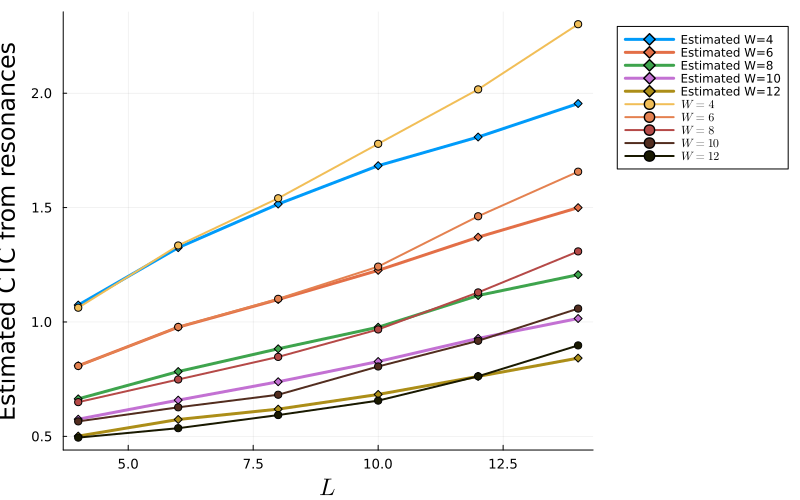

In [213]:
Ls=collect(range(start=4, stop=14, step=2))
Ws=collect(range(start=4, stop=12, step=2))

p = plot(xlabel=L"L", ylabel="Estimated CTC from resonances",
    xguidefontsize=16,
        yguidefontsize=16,
        titlefont=18,
        xtickfontsize=9,
        ytickfontsize=9,
legend=:outertopright)
        count1=1
count=1
for b in particles
means=Float64[]

for a in b
    push!(means, mean(a))
end
    plot!(p,Ls, means,marker=:diamond, linewidth=3, label="Estimated W="*string(Ws[count]))
    x = Ls
    y = means
    
    X = hcat(ones(length(x)), x)   # design matrix [1  x]
    β = X \ y                      # least squares solution
    
    intercept = β[1]
    slope = β[2]
    
    println("y ≈ $(intercept) + $(slope)x")
    count+=1
end

Ws=collect(range(start=4, stop=12, step=2))
Ls=collect(range(start=4, stop=14, step=2))
gradient = cgrad(:lajolla, length(Ls),rev=true)
slopes=[]
plots=[]


for v in Ws
    # All of the J=0.1 data!
    distribution1 = load_object("J=0.1 CTC/9_4_M_operator_norm_W=" * string(v) * ", J=0.1, t=1.jld2 2")

    distribution2 = load_object("more data j=0.1 ctc/9_3_M_operator_norm_W=" * string(v) * ", J=0.1, t=1.jld2")

    distribution3 = load_object("DCTC localized/8_21_M_DCTC_W=" * string(v) * ", J=0.1, t=1.jld2")
    distribution4 = load_object("8_26 more resolved operator norm CTC/8_26_M_operator_norm_W=" * string(v) * ", J=0.1, t=1.jld2")
    distribution1 = [vcat(distribution1[i], distribution3[i]) for i in eachindex(distribution1)]
    distribution1 = [vcat(distribution1[i], distribution4[i]) for i in eachindex(distribution1)]

    distribution1 = [vcat(distribution1[i], distribution2[i]) for i in eachindex(distribution1)]
    count = 1

    means=[]
        Ls=(collect(range(start=4, stop=14, step=2)))
        println(Ls)
        means=Float64[]
    #each is a list of lists of norms, sublist being the norm at each site
    # originally gs is a list of norms at a particular L
    means=Float64[]
    count=1
        for gs in distribution1
            temp=[]
            gs=vcat(gs...)
            push!(means, (mean(gs)))
            count+=1
        end
        index=trunc(Int, (count1/length(Ws))*256)
        plot!(p,(Ls), 2*(means), label=L"W=%$v", color=gradient[index], linewidth=2, marker=:circle, markersize=4, size=(800,500))
        println(means)

        count1+=1
end

display(p)

In [215]:
particles[5]

6-element Vector{Any}:
 Any[0.26300756763457556, 0.22710882920285008, 0.10926917925450191, 0.860407736734224, 0.461354869154473, 0.9323331820502885, 0.5822538142354882, 0.48865570924462454, 0.7457125743294937, 0.6876674203640143  …  0.8234753520594922, 0.10585299754858998, 0.9628981817873894, 0.4948413596581921, 0.5602761658049324, 1.0564147321021133, 0.16926342145577275, 0.37669109115258864, 0.43472207383143, 0.9486348062901975]
 Any[0.20609759346478101, 0.16837924233396512, 0.7763900720195771, 0.23023725451199467, 0.996628449615458, 1.0066551211637043, 0.9725156469535776, 0.11975147002040079, 0.09130232438416533, 1.03726241676208  …  1.1310776006588665, 0.18884328150352436, 0.43946089398634186, 0.1843659603494633, 1.2566386597169348, 0.3988678678088115, 0.2845909952549528, 0.4027105734198714, 1.002183067942429, 1.4568444197501909]
 Any[0.7768908592195001, 0.2040194644191683, 0.3699842056608674, 0.9260032944782081, 0.18428195711732823, 0.8162411571702783, 1.9418005573472858, 0.2016237

In [230]:

distribution1 = load_object("J=0.1 CTC/9_4_M_operator_norm_W=10, J=0.1, t=1.jld2 2")

distribution2 = load_object("more data j=0.1 ctc/9_3_M_operator_norm_W=10, J=0.1, t=1.jld2")

distribution3 = load_object("DCTC localized/8_21_M_DCTC_W=10, J=0.1, t=1.jld2")
distribution4 = load_object("8_26 more resolved operator norm CTC/8_26_M_operator_norm_W=10, J=0.1, t=1.jld2")
distribution1 = [vcat(distribution1[i], distribution3[i]) for i in eachindex(distribution1)]
distribution1 = [vcat(distribution1[i], distribution4[i]) for i in eachindex(distribution1)]

distribution1 = [vcat(distribution1[i], distribution2[i]) for i in eachindex(distribution1)]

6-element Vector{Vector{Any}}:
 [0.1017804521568188, 0.5595617608151291, 0.5309548407699911, 0.14561501741966526, 0.24617758649653504, 0.3123687706257568, 0.11273102751587721, 0.6202906425267432, 0.204540888751116, 0.5211958315296312  …  0.5017566571431524, 0.1572265778600991, 0.15853257009386698, 0.13284277040776568, 0.3000211186758138, 0.14897187557356167, 0.3136744027577103, 0.3212568373508251, 0.657934814728284, 0.24169400581543254]
 [0.10185551226096827, 0.4407952191681088, 0.39206642545483894, 0.2290705645408711, 0.28660913682504496, 0.09394462929762096, 0.4798871506043981, 0.09623702248362814, 0.18575436025953002, 0.14701829339629607  …  0.1710377733458966, 0.732491933369518, 0.5047311065390995, 0.376516807403084, 0.4421927762916882, 0.1690961085590149, 0.14620538246595938, 0.4627052661532264, 0.393235234907345, 0.2899717082707171]
 [0.4944197272200668, 0.3231660185158077, 0.4338053287446434, 0.10101234836798625, 0.2735282881907089, 0.28468060416833246, 0.2272473236621635, 0.506

In [227]:
maximum(particles[5][4])

2.3117763717687687

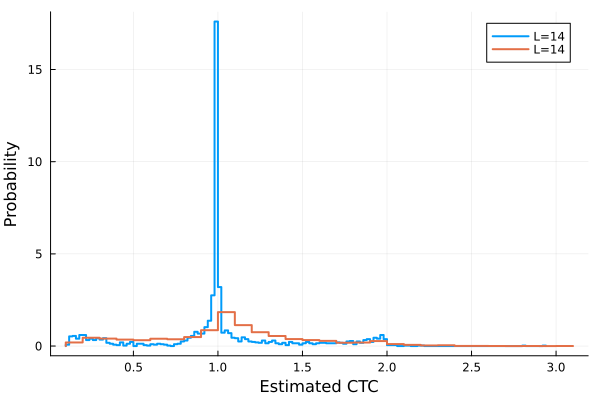

In [237]:
stephist(particles[4][6], xlabel="Estimated CTC", ylabel="Probability", linewidth=2, label="L=14", norm=true)

stephist!(2*distribution1[6], xlabel="Estimated CTC", ylabel="Probability", linewidth=2, label="L=14", norm=true)

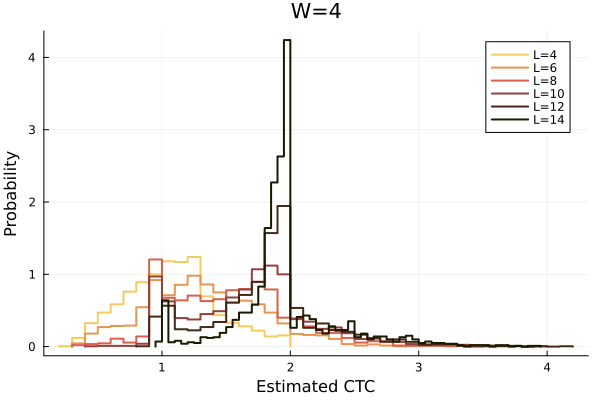

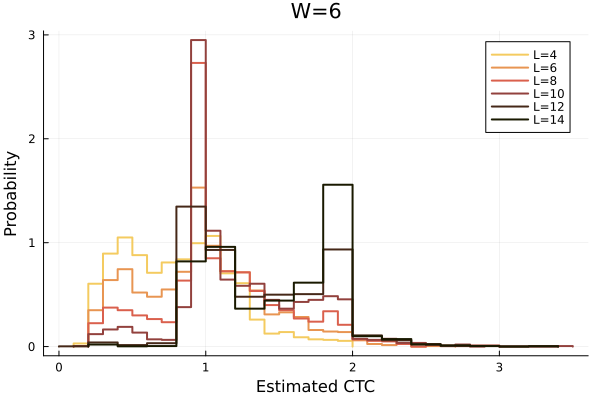

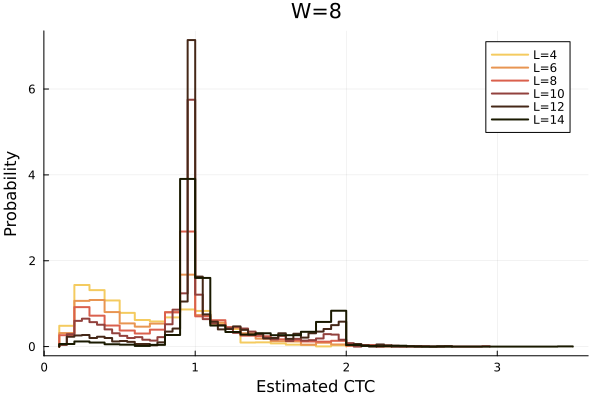

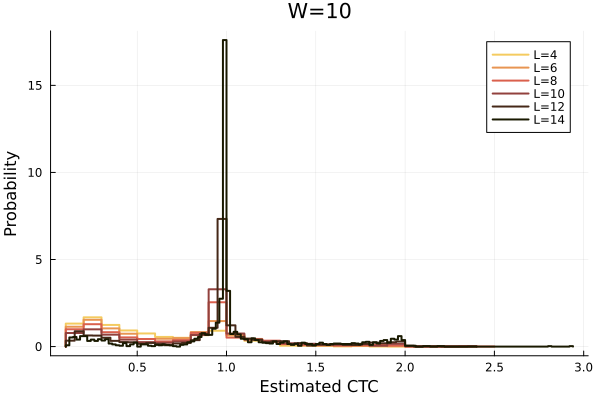

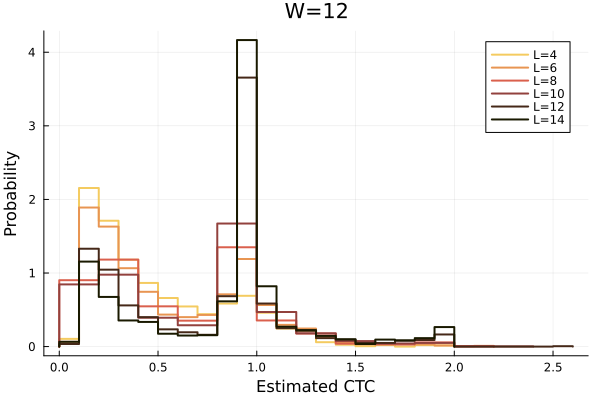

In [32]:
i=1
gradient = cgrad(:lajolla, length(Ls),rev=true)

for b in particles
    p=plot(title="W="*string(Ws[i]), linewidth=2)
means=[]
count=1
for a in b
    index=trunc(Int, (count/length(Ls))*256)
    stephist!(p,a, xlabel="Estimated CTC", ylabel="Probability", linewidth=2, label="L="*string(Ls[count]), norm=true, color=gradient[index])
    count+=1
end
    display(p)
    i+=1
end


In [ ]:
i=1
gradient = cgrad(:lajolla, length(Ls),rev=true)

particles[]

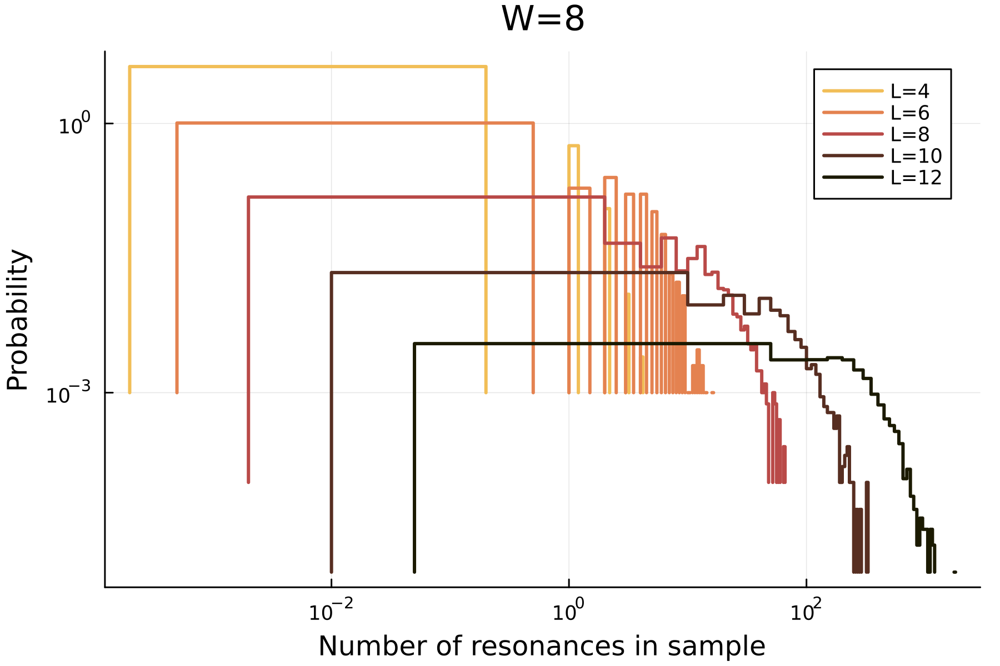

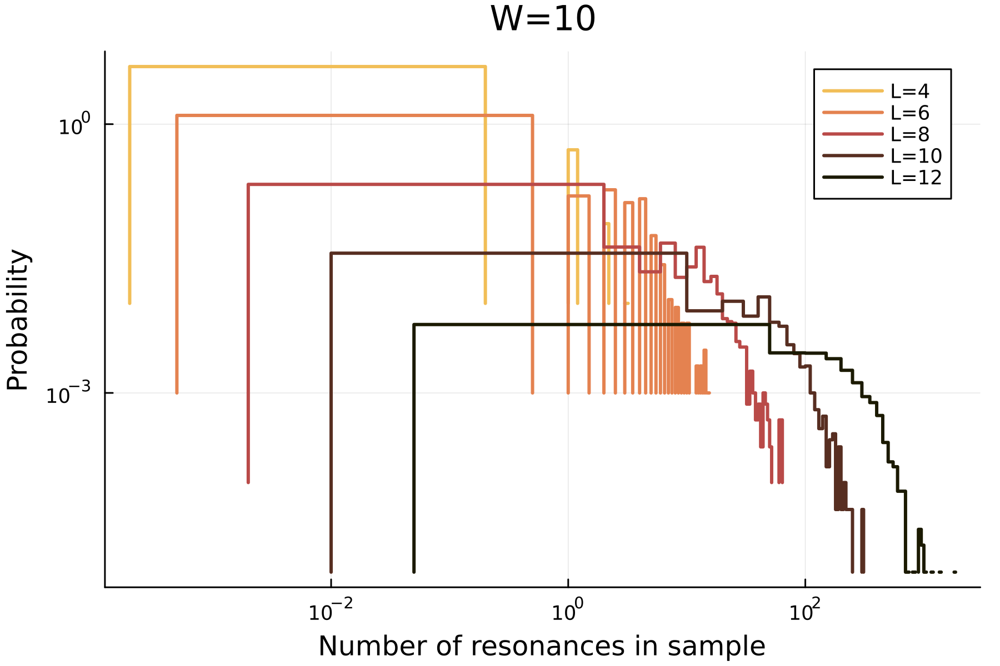

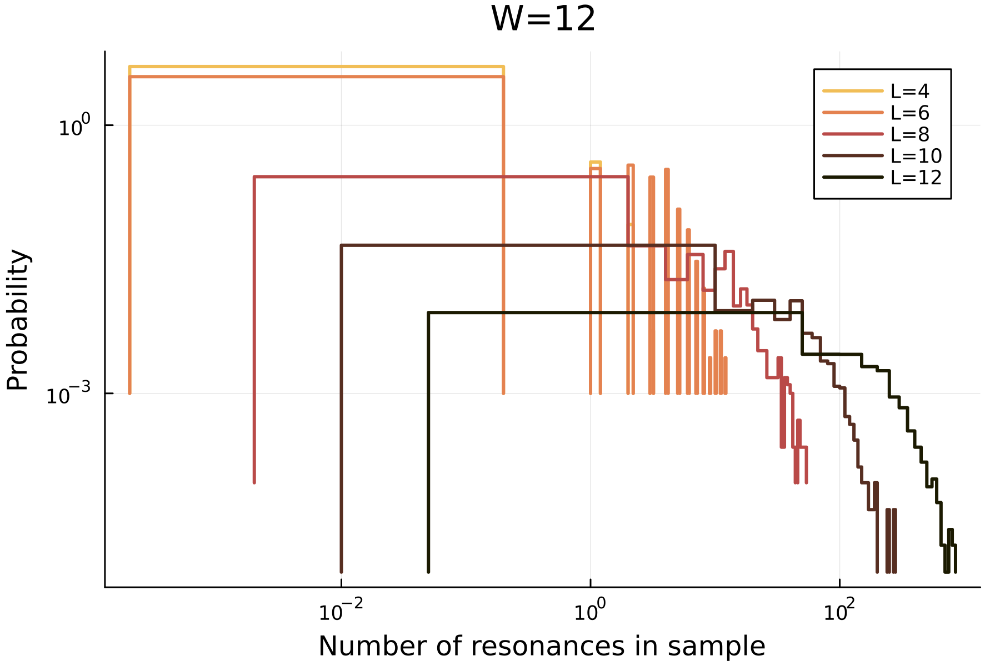

In [1262]:
i=1
gradient = cgrad(:lajolla, length(Ls),rev=true)

for b in resonances
    p=plot(title="W="*string(Ws[i]), linewidth=2)
means=[]
count=1
for a in b
    index=trunc(Int, (count/length(Ls))*256)
    stephist!(p,a, xlabel="Number of resonances in sample", ylabel="Probability", linewidth=2, label="L="*string(Ls[count]), norm=true, color=gradient[index], yaxis=:log, xaxis=:log)
    count+=1
end
    display(p)
    i+=1
end


In [107]:
xi=6
r=4
    off_diagonal_matrix_element=exp(-(r-1)/xi)*sqrt(r)

# if xi is large, the off diagonal matrix element is large, so most LIOM configurations will be resonating anyway in the first place since 
# the difference in energy will be 

1.2130613194252668

In [106]:
lhs(2, 3, xi)

0.14553767786114968

In [120]:
function compute_max_resonance_distance(xi)
    r=4
    off_diagonal_matrix_element=exp(-(r-1)/xi)*sqrt(r)
    
    function lhs(d, dd, xi)
        return abs(exp(-d/xi)-exp(-dd/xi))
    end
    
    minimums=[]
    for d=1:10
        for dd=1:10
            if(lhs(d, dd, xi)>=off_diagonal_matrix_element)
                println("d: ", d)
                println("dd: ", dd)
                push!(minimums, min(d, dd))
            end
        end
    end
    return maximum(minimums)
end

xi=collect(range(start=0, stop=1.4426950409, step=0.01));

In [93]:
xi

31-element Vector{Float64}:
 0.0
 0.1
 0.2
 0.3
 0.4
 0.5
 0.6
 0.7
 0.8
 0.9
 1.0
 1.1
 1.2
 ⋮
 1.9
 2.0
 2.1
 2.2
 2.3
 2.4
 2.5
 2.6
 2.7
 2.8
 2.9
 3.0

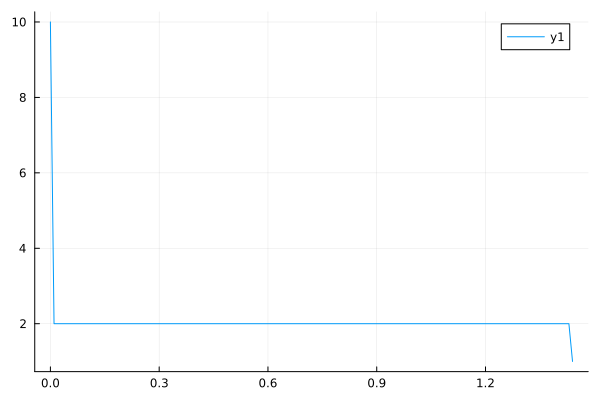

In [118]:
plot(xi, compute_max_resonance_distance.(xi))

In [70]:
off_diagonal_matrix_element

0.09957413673572789

In [71]:
lhs(1, 2, xi)

4.670774270471606

In [195]:
distribution1 = load_object("L 16 J 0.1/nersc test/1_13_M_operator_norm_W=1, J=0.1, t=1.jld2")

┌ Warning: This file was written in a newer version of the JLD2 file format.
│ Please consider updating JLD2.
└ @ JLD2 ~/.julia/packages/JLD2/twZ5D/src/file_header.jl:39
┌ Warning: This file was written with a different version of JLD2 that may not be compatible.
│ Attempting to load data.
└ @ JLD2 ~/.julia/packages/JLD2/twZ5D/src/file_header.jl:43


1-element Vector{Any}:
 Any[6.624922829226822, 6.8049626886809005, 7.547876565319335, 7.106061183501948, 5.9581857796463, 7.270967187459981, 6.837114059407601, 7.583961936153079, 6.055736846641768, 6.960375267501151  …  6.65475105237565, 6.918717297402166, 6.4314033925801635, 7.730422023006927, 7.237022712219908, 7.767221884225149, 6.945879053654516, 6.896758878733902, 7.257958609411753, 6.71579656052331]

In [198]:
length(distribution1[1])

100

In [212]:
using Dates
lalala1=[1, 2]
timestamp = Dates.format(now(), "mm-dd_HH-MM-SS")
outdir = joinpath("NERSC runs", timestamp)
mkpath(outdir)
save_object("lalallaa"*timestamp*".jld2", lalala1)